# To do
+ Get Industry Labels
+ Confusion Matrix between Classes and Industry
+ Better Cluster Visualisation and optimisation


# Because Kmeans library is being dumb

In [139]:
import os
os.environ["OPENBLAS_NUM_THREADS"] = "1"


# Imports

In [70]:
import pandas as pd
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
import numpy as np
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import math
from scipy.cluster.hierarchy import linkage, dendrogram, fcluster
from sklearn.preprocessing import QuantileTransformer
from sklearn.cluster import DBSCAN
from sklearn.metrics import pairwise_distances
from sklearn.preprocessing import RobustScaler
from sklearn.metrics import silhouette_score
from sklearn.linear_model import LinearRegression

# Pre Processing
+ Reading in Data
+ Removing Na
+ Standardising
+ Converting to numpy array
+ Doing some Transpositioning in between because fuck bloomberg

##### Read In Data

In [71]:
df_1 = pd.read_csv("JSE_2025_Raw_Returns.csv") # Read in Data
df_1 = df_1.set_index(['Current'])# Set Index to Start Date
df_1

,BOE SJ Equity,CXT SJ Equity,GBL SJ Equity,GLT SJ Equity,ITV SJ Equity,JCG SJ Equity,MBT SJ Equity,MHH SJ Equity,MLB SJ Equity,MOZ SJ Equity,...,MCZ SJ Equity,TGA SJ Equity,MKR SJ Equity,ENV SJ Equity,IOC SJ Equity,AHR SJ Equity,BOX SJ Equity,SRI SJ Equity,NTU SJ Equity,VAL SJ Equity
Current,,,,,,,,,,,,,,,,,,,,,
31-Dec-00,0.05,0.00,0.01,-0.03,-0.01,0.01,-0.05,0.02,-0.04,-0.08,...,-,-,-,0.00,0.00,-,-,-,-,0.02
07-Jan-01,0.08,0.07,0.03,0.00,0.00,-0.04,0.20,0.01,0.08,0.14,...,-,-,-,0.00,0.00,-,-,-,-,-0.03
14-Jan-01,-0.07,0.17,-0.02,-0.03,0.00,0.00,0.00,-0.07,-0.04,0.20,...,-,-,-,-0.03,0.00,-,-,-,-,0.03
21-Jan-01,-0.02,-0.02,0.03,0.08,0.31,-0.02,0.00,0.23,-0.07,0.08,...,-,-,-,-0.03,0.00,-,-,-,-,-0.04
28-Jan-01,0.02,-0.06,0.04,0.23,-0.08,0.01,0.13,0.07,0.05,-0.01,...,-,-,-,-0.29,-0.04,-,-,-,-,0.02
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
04-May-25,-,-,-,-,-,-,-,-,-,-,...,-0.04,-0.01,0.03,-,0.07,-0.01,0.04,-0.04,-0.03,0.00
11-May-25,-,-,-,-,-,-,-,-,-,-,...,0.04,-0.09,-0.02,-,0.06,-0.01,-0.05,-0.04,-0.03,0.01
18-May-25,-,-,-,-,-,-,-,-,-,-,...,0.07,0.00,-0.06,-,-0.01,0.00,-0.05,0.04,0.07,-0.05


In [72]:
alse_consitutents = pd.read_csv("companies-list.csv")
alse_consitutents["Code"] = alse_consitutents["Code"].str[4:]
alse_consitutents["Code"] = alse_consitutents["Code"] + " SJ Equity"
alse_consitutents = alse_consitutents.sort_values('Market Cap', ascending=False)
alse_consitutents = alse_consitutents.iloc[0:100, :]
alse_consitutents_list = alse_consitutents['Code'].to_list()


##### Replace Dashes with nan's

In [73]:
df_1.replace("-", np.nan, inplace=True) # Replace all "-" with NAn
df_1 = df_1.apply(pd.to_numeric, errors='coerce') # Convert Columns to numeric

df_1

/var/folders/hs/v5c0lrnj61z3tp745vdhh0m40000gn/T/ipykernel_75018/1560927017.py:1: FutureWarning: Downcasting behavior in `replace` is deprecated and will be removed in a future version. To retain the old behavior, explicitly call `result.infer_objects(copy=False)`. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`
  df_1.replace("-", np.nan, inplace=True) # Replace all "-" with NAn


,BOE SJ Equity,CXT SJ Equity,GBL SJ Equity,GLT SJ Equity,ITV SJ Equity,JCG SJ Equity,MBT SJ Equity,MHH SJ Equity,MLB SJ Equity,MOZ SJ Equity,...,MCZ SJ Equity,TGA SJ Equity,MKR SJ Equity,ENV SJ Equity,IOC SJ Equity,AHR SJ Equity,BOX SJ Equity,SRI SJ Equity,NTU SJ Equity,VAL SJ Equity
Current,,,,,,,,,,,,,,,,,,,,,
31-Dec-00,0.05,0.00,0.01,-0.03,-0.01,0.01,-0.05,0.02,-0.04,-0.08,...,NaN,NaN,NaN,0.00,0.00,NaN,NaN,NaN,NaN,0.02
07-Jan-01,0.08,0.07,0.03,0.00,0.00,-0.04,0.20,0.01,0.08,0.14,...,NaN,NaN,NaN,0.00,0.00,NaN,NaN,NaN,NaN,-0.03
14-Jan-01,-0.07,0.17,-0.02,-0.03,0.00,0.00,0.00,-0.07,-0.04,0.20,...,NaN,NaN,NaN,-0.03,0.00,NaN,NaN,NaN,NaN,0.03
21-Jan-01,-0.02,-0.02,0.03,0.08,0.31,-0.02,0.00,0.23,-0.07,0.08,...,NaN,NaN,NaN,-0.03,0.00,NaN,NaN,NaN,NaN,-0.04
28-Jan-01,0.02,-0.06,0.04,0.23,-0.08,0.01,0.13,0.07,0.05,-0.01,...,NaN,NaN,NaN,-0.29,-0.04,NaN,NaN,NaN,NaN,0.02
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
04-May-25,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,-0.04,-0.01,0.03,NaN,0.07,-0.01,0.04,-0.04,-0.03,0.00
11-May-25,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.04,-0.09,-0.02,NaN,0.06,-0.01,-0.05,-0.04,-0.03,0.01
18-May-25,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,0.07,0.00,-0.06,NaN,-0.01,0.00,-0.05,0.04,0.07,-0.05


Correlation Backfill

In [74]:
corr_matrix = df_1.corr()
stocklist = df_1.columns.values.tolist()
for stock_name in df_1.columns.values.tolist():
    for i, value in enumerate(df_1[stock_name]):
        if math.isnan(value):
            print(f"Found NaN for {stock_name} dated {df_1.index[i]}")
            
            correlated_stocks = corr_matrix[stock_name].drop(stock_name).nlargest(3).index.tolist()
            print(f"Top correlated stocks: {correlated_stocks}")

            replacement_values = []
            for correlated_stock in correlated_stocks:
                val = df_1.iloc[i, stocklist.index(correlated_stock)]
                if not math.isnan(val):
                    replacement_values.append(val)
            
            if len(replacement_values) == 0:
                "Fokol we can do chief"
            else:
                replacement = sum(replacement_values) / len(replacement_values)
                df_1.iat[i, stocklist.index(stock_name)] = replacement
                print(f"Replaced with value: {replacement}")

Found NaN for BOE SJ Equity dated 14-Jul-02
Top correlated stocks: ['CPI SJ Equity', 'SLM SJ Equity', 'FSR SJ Equity']
Replaced with value: -0.02
Found NaN for BOE SJ Equity dated 21-Jul-02
Top correlated stocks: ['CPI SJ Equity', 'SLM SJ Equity', 'FSR SJ Equity']
Replaced with value: -0.023333333333333334
Found NaN for BOE SJ Equity dated 28-Jul-02
Top correlated stocks: ['CPI SJ Equity', 'SLM SJ Equity', 'FSR SJ Equity']
Replaced with value: -0.016666666666666666
Found NaN for BOE SJ Equity dated 04-Aug-02
Top correlated stocks: ['CPI SJ Equity', 'SLM SJ Equity', 'FSR SJ Equity']
Replaced with value: -0.01666666666666667
Found NaN for BOE SJ Equity dated 11-Aug-02
Top correlated stocks: ['CPI SJ Equity', 'SLM SJ Equity', 'FSR SJ Equity']
Replaced with value: 0.06666666666666667
Found NaN for BOE SJ Equity dated 18-Aug-02
Top correlated stocks: ['CPI SJ Equity', 'SLM SJ Equity', 'FSR SJ Equity']
Replaced with value: 0.04666666666666666
Found NaN for BOE SJ Equity dated 25-Aug-02
Top c

##### transpose 
to structure data for classyfying stocks on returns

In [75]:
df_1 = df_1.T #Transpose to structure to remove nan rows
df_1 = df_1.dropna()
df_1

Current,31-Dec-00,07-Jan-01,14-Jan-01,21-Jan-01,28-Jan-01,04-Feb-01,11-Feb-01,18-Feb-01,25-Feb-01,04-Mar-01,...,30-Mar-25,06-Apr-25,13-Apr-25,20-Apr-25,27-Apr-25,04-May-25,11-May-25,18-May-25,25-May-25,01-Jun-25
BOE SJ Equity,0.050000,0.080000,-0.070000,-0.020000,0.020000,0.060000,-0.040000,-0.010000,-0.010000,-0.060000,...,-0.016667,-0.120,0.076667,0.053333,0.060000,0.020000,-0.010000,0.036667,-0.030000,0.023333
CXT SJ Equity,0.000000,0.070000,0.170000,-0.020000,-0.060000,0.050000,-0.010000,0.010000,-0.030000,-0.050000,...,-0.015000,-0.080,0.030000,0.015000,0.015000,0.035000,-0.040000,0.020000,0.020000,0.020000
GBL SJ Equity,0.010000,0.030000,-0.020000,0.030000,0.040000,0.030000,-0.040000,-0.010000,-0.010000,-0.060000,...,0.025000,-0.055,0.035000,0.025000,0.005000,0.045000,-0.015000,0.055000,0.000000,0.025000
GLT SJ Equity,-0.030000,0.000000,-0.030000,0.080000,0.230000,-0.130000,0.060000,0.080000,-0.060000,-0.030000,...,0.137778,-0.070,0.042222,-0.002222,0.063333,0.063333,-0.016667,0.005556,-0.003333,0.007778
ITV SJ Equity,-0.010000,0.000000,0.000000,0.310000,-0.080000,0.230000,-0.080000,-0.100000,0.110000,0.030000,...,0.000000,-0.045,0.005000,0.070000,-0.005000,0.010000,0.005000,0.015000,-0.020000,0.050000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
AHR SJ Equity,0.020000,0.025000,0.015000,-0.005000,0.035000,-0.010000,0.000000,0.020000,-0.045000,-0.010000,...,-0.160000,0.010,0.060000,0.000000,0.010000,-0.010000,-0.010000,0.000000,0.000000,-0.010000
BOX SJ Equity,0.013889,0.016111,-0.001111,0.027222,-0.006667,0.055000,-0.026111,0.046111,-0.022778,-0.011111,...,-0.020000,-0.110,0.040000,0.010000,0.030000,0.040000,-0.050000,-0.050000,0.000000,0.040000
SRI SJ Equity,0.020000,0.025000,0.015000,-0.005000,0.035000,-0.010000,0.000000,0.020000,-0.045000,-0.010000,...,-0.030000,-0.010,0.070000,0.020000,0.060000,-0.040000,-0.040000,0.040000,-0.050000,0.020000
NTU SJ Equity,0.036667,0.018333,0.041667,-0.005000,0.008333,0.073333,-0.063333,0.010000,-0.025000,0.000000,...,-0.040000,-0.110,0.020000,-0.040000,0.080000,-0.030000,-0.030000,0.070000,-0.360000,0.090000


In [76]:
df_1 = df_1[df_1.index.isin(alse_consitutents_list)]

In [354]:
df_1

Current,31-Dec-00,07-Jan-01,14-Jan-01,21-Jan-01,28-Jan-01,04-Feb-01,11-Feb-01,18-Feb-01,25-Feb-01,04-Mar-01,...,30-Mar-25,06-Apr-25,13-Apr-25,20-Apr-25,27-Apr-25,04-May-25,11-May-25,18-May-25,25-May-25,01-Jun-25
DTC SJ Equity,0.040000,-0.030000,0.000000,0.090000,0.070000,-0.060000,-0.200000,-0.030000,-0.110000,-0.150000,...,0.06,-0.01,0.02,0.03,0.00,0.05,0.01,0.04,-0.01,0.01
BYI SJ Equity,0.030000,-0.020000,0.060000,0.010000,0.060000,-0.010000,-0.030000,-0.070000,-0.070000,0.020000,...,0.02,-0.03,0.04,0.04,-0.02,0.04,0.04,-0.08,-0.02,0.06
KRO SJ Equity,0.020000,-0.055000,-0.015000,-0.055000,-0.005000,-0.075000,0.080000,0.080000,-0.105000,0.020000,...,-0.02,-0.05,0.01,-0.01,0.08,-0.02,0.00,0.20,0.01,0.03
NPN SJ Equity,0.060000,0.070000,-0.060000,0.200000,0.000000,0.080000,-0.020000,-0.040000,-0.090000,-0.040000,...,-0.01,-0.04,-0.03,0.05,0.09,0.04,0.00,0.05,-0.03,0.00
PRX SJ Equity,0.045000,0.010000,0.005000,0.135000,-0.010000,0.030000,0.010000,-0.040000,-0.060000,-0.045000,...,0.00,-0.05,-0.03,0.02,0.08,0.03,0.00,0.04,-0.02,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
EXX SJ Equity,0.011667,0.038333,0.030000,0.048333,0.005000,0.056667,-0.045000,0.075000,-0.023333,-0.013333,...,0.00,-0.07,0.03,0.02,0.02,0.02,-0.03,0.01,-0.01,0.03
TGA SJ Equity,0.013333,0.039167,0.028750,0.036667,0.011250,0.052083,-0.057500,0.068750,-0.030417,-0.017917,...,-0.04,-0.09,-0.02,0.07,0.03,-0.01,-0.09,0.00,0.05,0.03
BOX SJ Equity,0.013889,0.016111,-0.001111,0.027222,-0.006667,0.055000,-0.026111,0.046111,-0.022778,-0.011111,...,-0.02,-0.11,0.04,0.01,0.03,0.04,-0.05,-0.05,0.00,0.04
SRI SJ Equity,0.020000,0.025000,0.015000,-0.005000,0.035000,-0.010000,0.000000,0.020000,-0.045000,-0.010000,...,-0.03,-0.01,0.07,0.02,0.06,-0.04,-0.04,0.04,-0.05,0.02


In [ ]:
#df_1 = df_1.drop("PMR SJ Equity")

In [103]:
overall_corr_matrix = df_1.T.corr()
overall_corr_matrix

,DTC SJ Equity,BYI SJ Equity,KRO SJ Equity,NPN SJ Equity,PRX SJ Equity,MCG SJ Equity,MTN SJ Equity,TKG SJ Equity,BLU SJ Equity,VOD SJ Equity,...,IMP SJ Equity,NPH SJ Equity,SSW SJ Equity,SOL SJ Equity,OMN SJ Equity,EXX SJ Equity,TGA SJ Equity,BOX SJ Equity,SRI SJ Equity,VAL SJ Equity
DTC SJ Equity,1.000000,0.183731,0.066712,0.249280,0.294145,0.162986,0.281525,0.206169,0.161667,0.182901,...,0.239493,0.245689,0.153674,0.202739,0.141019,0.219056,0.211684,0.303683,0.234380,0.205045
BYI SJ Equity,0.183731,1.000000,0.039559,0.114128,0.126298,0.081760,0.197091,0.156022,0.121973,0.126898,...,0.168117,0.172905,0.109151,0.158523,0.142023,0.112550,0.098504,0.252506,0.208424,0.141083
KRO SJ Equity,0.066712,0.039559,1.000000,0.026411,0.044114,0.033819,0.056073,0.050857,0.056788,0.065792,...,0.049375,0.042478,0.045391,0.125034,0.069271,0.073398,0.072388,0.137088,0.111020,0.050776
NPN SJ Equity,0.249280,0.114128,0.026411,1.000000,0.844674,0.145559,0.258510,0.185948,0.156042,0.207404,...,0.194828,0.170530,0.105600,0.144072,0.109446,0.169832,0.154807,0.264902,0.181866,0.182194
PRX SJ Equity,0.294145,0.126298,0.044114,0.844674,1.000000,0.190200,0.238245,0.179821,0.141791,0.232863,...,0.225501,0.216113,0.136704,0.169169,0.094527,0.213139,0.192167,0.310390,0.179113,0.215425
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
EXX SJ Equity,0.219056,0.112550,0.073398,0.169832,0.213139,0.113852,0.292323,0.150302,0.169876,0.116115,...,0.424581,0.381753,0.325733,0.391852,0.167980,1.000000,0.783924,0.462736,0.199846,0.450231
TGA SJ Equity,0.211684,0.098504,0.072388,0.154807,0.192167,0.162327,0.270306,0.162070,0.161094,0.131715,...,0.402106,0.354345,0.293160,0.435003,0.186125,0.783924,1.000000,0.513456,0.213626,0.433365
BOX SJ Equity,0.303683,0.252506,0.137088,0.264902,0.310390,0.243906,0.391668,0.266714,0.216914,0.270775,...,0.426658,0.372940,0.270589,0.442142,0.233527,0.462736,0.513456,1.000000,0.344285,0.442447
SRI SJ Equity,0.234380,0.208424,0.111020,0.181866,0.179113,0.107917,0.287885,0.245447,0.221356,0.137457,...,0.214837,0.191400,0.106009,0.389630,0.214051,0.199846,0.213626,0.344285,1.000000,0.167090


# KMeans Clustering

In [110]:
pca = PCA(n_components=1)
pc1 = pca.fit_transform(df_1)
df_1_demeaned = df_1 - df_1.mean(axis=0)
df_1_residuls = []
columns = df_1.columns.values.tolist()
stocks = df_1.index.to_list()

for i in range(df_1.shape[1]):
    model = LinearRegression().fit(pc1,df_1.iloc[:,i])
    fitted = model.predict(pc1)
    residuals = df_1.iloc[:,i]-fitted
    df_1_residuls.append(residuals)
    
df_1_excl_market = np.array(df_1_residuls).T

df_1_excl_market = pd.DataFrame(df_1_excl_market, columns = columns)
df_1_excl_market['Stocks'] = stocks
df_1_excl_market = df_1_excl_market.set_index(['Stocks'])
df_1_excl_market

,31-Dec-00,07-Jan-01,14-Jan-01,21-Jan-01,28-Jan-01,04-Feb-01,11-Feb-01,18-Feb-01,25-Feb-01,04-Mar-01,...,30-Mar-25,06-Apr-25,13-Apr-25,20-Apr-25,27-Apr-25,04-May-25,11-May-25,18-May-25,25-May-25,01-Jun-25
Stocks,,,,,,,,,,,,,,,,,,,,,
DTC SJ Equity,0.022587,-0.040739,-0.031054,0.075904,0.054236,-0.065191,-0.177493,-0.040458,-0.092152,-0.144719,...,0.059465,0.079790,-0.042502,-0.010075,-0.013807,0.029219,0.016230,0.031676,-0.028152,-0.005054
BYI SJ Equity,0.012561,-0.030711,0.029027,-0.004108,0.044518,-0.014915,-0.007686,-0.080354,-0.052008,0.025559,...,0.019492,0.060004,-0.022298,-0.000203,-0.033932,0.019095,0.046254,-0.088400,-0.037944,0.044838
KRO SJ Equity,0.002662,-0.065821,-0.046294,-0.069061,-0.021596,-0.081003,0.103075,0.069236,-0.087574,0.024461,...,-0.020615,0.039161,-0.053104,-0.049696,0.066561,-0.040416,0.006160,0.191899,-0.008767,0.015265
NPN SJ Equity,0.042526,0.059326,-0.090862,0.185876,-0.015096,0.075461,0.002050,-0.050212,-0.071813,-0.034061,...,-0.010471,0.050295,-0.092019,0.009622,0.075897,0.018926,0.006287,0.041497,-0.047659,-0.015309
PRX SJ Equity,0.027531,-0.000679,-0.025878,0.120879,-0.025152,0.025406,0.032089,-0.050233,-0.041841,-0.039117,...,-0.000476,0.040253,-0.092059,-0.020353,0.065922,0.008951,0.006282,0.031512,-0.037700,-0.015288
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
EXX SJ Equity,-0.005695,0.027538,-0.001219,0.034262,-0.011336,0.050917,-0.022102,0.064331,-0.005775,-0.008617,...,-0.000590,0.019358,-0.032916,-0.019814,0.006446,-0.000530,-0.023818,0.001829,-0.028575,0.015166
TGA SJ Equity,-0.004016,0.028358,-0.002508,0.022601,-0.005221,0.046203,-0.034511,0.058032,-0.012927,-0.013332,...,-0.040603,-0.000744,-0.083013,0.030247,0.016506,-0.030471,-0.083830,-0.008135,0.031326,0.015217
BOX SJ Equity,-0.003517,0.005365,-0.032187,0.013130,-0.022507,0.049734,-0.003552,0.035625,-0.004968,-0.005906,...,-0.020542,-0.020267,-0.022557,-0.030040,0.016227,0.019253,-0.043776,-0.058304,-0.018209,0.024976


### Partitioning Data and Pre Processing

In [111]:
week_number_start = 500
week_number_end = 1275
df_to_Cluster_on = df_1_excl_market.iloc[:,week_number_start:week_number_end]
df_to_Cluster_on
stocks = df_to_Cluster_on.index.to_list()
columns = df_to_Cluster_on.columns.to_list()
df_to_Cluster_on

,01-Aug-10,08-Aug-10,15-Aug-10,22-Aug-10,29-Aug-10,05-Sep-10,12-Sep-10,19-Sep-10,26-Sep-10,03-Oct-10,...,30-Mar-25,06-Apr-25,13-Apr-25,20-Apr-25,27-Apr-25,04-May-25,11-May-25,18-May-25,25-May-25,01-Jun-25
Stocks,,,,,,,,,,,,,,,,,,,,,
DTC SJ Equity,0.039522,-0.004648,-0.052578,0.003710,0.034703,-0.036842,-0.021466,-0.042455,0.028084,-0.011183,...,0.059465,0.079790,-0.042502,-0.010075,-0.013807,0.029219,0.016230,0.031676,-0.028152,-0.005054
BYI SJ Equity,-0.000557,0.045383,0.022315,-0.001362,-0.005288,-0.061787,-0.011360,-0.017642,-0.016937,-0.031258,...,0.019492,0.060004,-0.022298,-0.000203,-0.033932,0.019095,0.046254,-0.088400,-0.037944,0.044838
KRO SJ Equity,-0.060243,-0.079736,0.047737,0.003924,0.154676,-0.002004,-0.001779,0.018096,-0.036855,0.014038,...,-0.020615,0.039161,-0.053104,-0.049696,0.066561,-0.040416,0.006160,0.191899,-0.008767,0.015265
NPN SJ Equity,0.019334,-0.004576,-0.022831,0.003539,-0.015275,0.013288,-0.001215,-0.022897,0.018035,0.028639,...,-0.010471,0.050295,-0.092019,0.009622,0.075897,0.018926,0.006287,0.041497,-0.047659,-0.015309
PRX SJ Equity,-0.005650,0.005418,-0.022810,0.023553,-0.020277,0.018277,0.013764,-0.017860,0.018039,0.018654,...,-0.000476,0.040253,-0.092059,-0.020353,0.065922,0.008951,0.006282,0.031512,-0.037700,-0.015288
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
EXX SJ Equity,-0.010316,-0.014709,0.007639,-0.026143,-0.025316,0.033047,-0.011681,-0.002076,-0.011874,-0.001031,...,-0.000590,0.019358,-0.032916,-0.019814,0.006446,-0.000530,-0.023818,0.001829,-0.028575,0.015166
TGA SJ Equity,-0.000279,-0.009723,-0.009811,-0.017359,-0.024070,0.034271,-0.014857,0.000513,-0.014990,-0.004120,...,-0.040603,-0.000744,-0.083013,0.030247,0.016506,-0.030471,-0.083830,-0.008135,0.031326,0.015217
BOX SJ Equity,0.002877,0.003122,-0.018660,0.004285,-0.005299,0.000921,-0.011495,-0.005738,-0.023577,-0.010607,...,-0.020542,-0.020267,-0.022557,-0.030040,0.016227,0.019253,-0.043776,-0.058304,-0.018209,0.024976


### Elbow Curve

In [112]:
# Remove Nan
df_to_Cluster_on = df_to_Cluster_on.dropna()
df_to_Cluster_on = df_to_Cluster_on.reset_index()
df_to_Cluster_on = df_to_Cluster_on.set_index(['Stocks'])

columns = df_to_Cluster_on.columns.values.tolist()
# Robust Scale
"""scaler = RobustScaler()
df_to_Cluster_on = scaler.fit_transform(df_to_Cluster_on)
df_to_Cluster_on = pd.DataFrame(df_to_Cluster_on, columns=columns)
df_to_Cluster_on['Stock'] = stocks
df_to_Cluster_on = df_to_Cluster_on.set_index(['Stock'])
df_to_Cluster_on"""

# Winsorise
scaler = StandardScaler()
df_to_Cluster_on = scaler.fit_transform(df_to_Cluster_on)
df_to_Cluster_on = pd.DataFrame(df_to_Cluster_on, columns=columns)
df_to_Cluster_on['Stock'] = stocks
df_to_Cluster_on = df_to_Cluster_on.set_index(['Stock'])
df_to_Cluster_on = df_to_Cluster_on.clip(lower=-10, upper=10)
#df_to_Cluster_on = df_to_Cluster_on.drop(['HAR SJ Equity', 'SNT SJ Equity'])

/opt/anaconda3/envs/dataAnalysis/lib/python3.12/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)
/opt/anaconda3/envs/dataAnalysis/lib/python3.12/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)
/opt/anaconda3/envs/dataAnalysis/lib/python3.12/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not

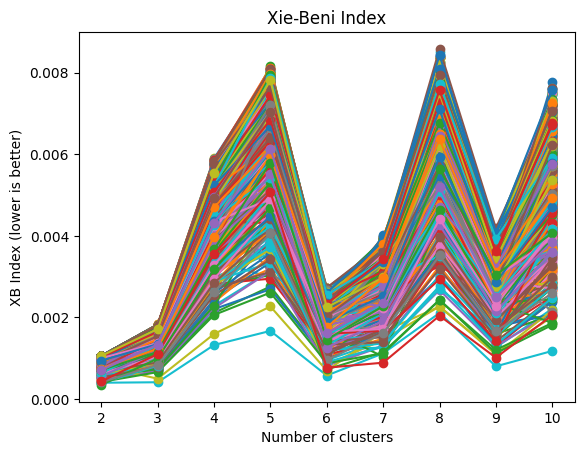

In [113]:
from sklearn.cluster import KMeans
from sklearn.metrics import pairwise_distances_argmin_min
from scipy.spatial.distance import cdist
import numpy as np

def xie_beni_index(X, labels, centroids):
    k = len(np.unique(labels))
    n = X.shape[0]
    intra_sum = 0

    for i in range(k):
        cluster_points = X[labels == i]
        intra_sum += np.sum((cluster_points - centroids[i])**2)

    centroid_dists = cdist(centroids, centroids)
    # avoid zero diagonal
    np.fill_diagonal(centroid_dists, np.inf)
    min_dist = np.min(centroid_dists)**2

    return intra_sum / (n * min_dist)

# Try for a range of clusters
xb_scores = []
K = range(2, 11)

for k in K:
    kmeans = KMeans(n_clusters=k, n_init=10, random_state=42).fit(df_to_Cluster_on)
    labels = kmeans.labels_
    centroids = kmeans.cluster_centers_
    xb = xie_beni_index(df_to_Cluster_on, labels, centroids)
    xb_scores.append(xb)

# Plot
import matplotlib.pyplot as plt
plt.plot(K, xb_scores, marker='o')
plt.title('Xie-Beni Index')
plt.xlabel('Number of clusters')
plt.ylabel('XB Index (lower is better)')
plt.show()

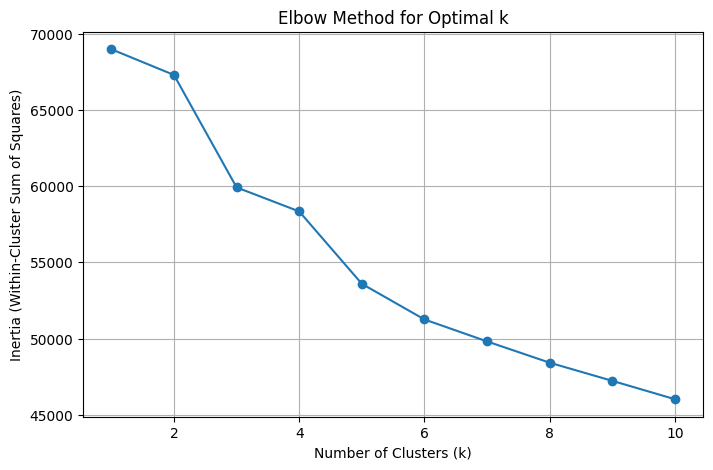

In [114]:
k_values = range(1, 11)
inertias = []

for k in k_values:
    kmeans = KMeans(n_clusters=k, random_state=4)
    kmeans.fit(df_to_Cluster_on)
    inertias.append(kmeans.inertia_)

# Plot the elbow curve
plt.figure(figsize=(8, 5))
plt.plot(k_values, inertias, marker='o')
plt.title("Elbow Method for Optimal k")
plt.xlabel("Number of Clusters (k)")
plt.ylabel("Inertia (Within-Cluster Sum of Squares)")
plt.grid(True)
plt.show()

### Cluster Visualisation

5 Clusters: 


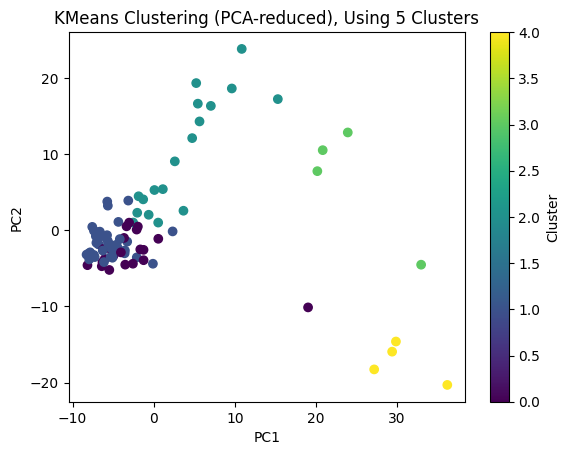

Silhouette Score: 0.0597
Overall Average pairwise correlation: -0.0001
Cluster 0 Average pairwise correlation: 0.0003 and -4.18 times overall With  22
<table border="1" class="dataframe">
  <thead>
    <tr style="text-align: right;">
      <th></th>
      <th>Code</th>
      <th>Company</th>
      <th>Market Cap</th>
      <th>Sector</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <th>3</th>
      <td>BTI SJ Equity</td>
      <td>British American Tobacco (JSE:BTI)</td>
      <td>1987650000000</td>
      <td>Consumer Goods</td>
    </tr>
    <tr>
      <th>21</th>
      <td>BID SJ Equity</td>
      <td>Bid Corporation Limited (JSE:BID)</td>
      <td>155313000000</td>
      <td>Consumer Services</td>
    </tr>
    <tr>
      <th>49</th>
      <td>GRT SJ Equity</td>
      <td>Growthpoint Properties Limited (JSE:GRT)</td>
      <td>47276200000</td>
      <td>Financials</td>
    </tr>
    <tr>
      <th>54</th>
      <td>HMN SJ Equity</td>
      <td>Hammerson plc (JSE:HMN)</td>
      <t

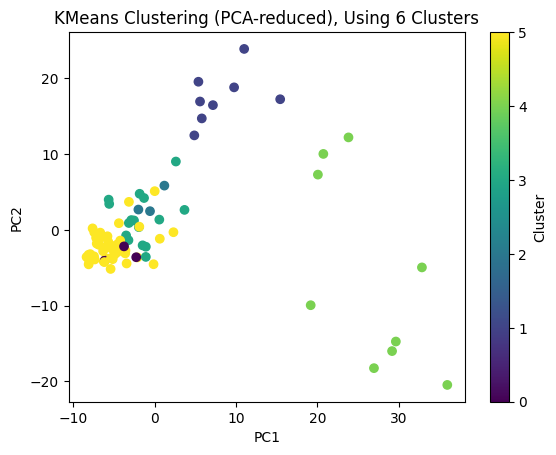

Silhouette Score: 0.0362
Overall Average pairwise correlation: -0.0001
Cluster 3 Average pairwise correlation: 0.0006 and -8.85 times overall With  16
<table border="1" class="dataframe">
  <thead>
    <tr style="text-align: right;">
      <th></th>
      <th>Code</th>
      <th>Company</th>
      <th>Market Cap</th>
      <th>Sector</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <th>2</th>
      <td>ANH SJ Equity</td>
      <td>Anheuser-Busch Inbev (JSE:ANH)</td>
      <td>2201800000000</td>
      <td>Consumer Goods</td>
    </tr>
    <tr>
      <th>3</th>
      <td>BTI SJ Equity</td>
      <td>British American Tobacco (JSE:BTI)</td>
      <td>1987650000000</td>
      <td>Consumer Goods</td>
    </tr>
    <tr>
      <th>21</th>
      <td>BID SJ Equity</td>
      <td>Bid Corporation Limited (JSE:BID)</td>
      <td>155313000000</td>
      <td>Consumer Services</td>
    </tr>
    <tr>
      <th>24</th>
      <td>MNP SJ Equity</td>
      <td>Mondi plc (JSE:MNP)</td>
      <td>1270830

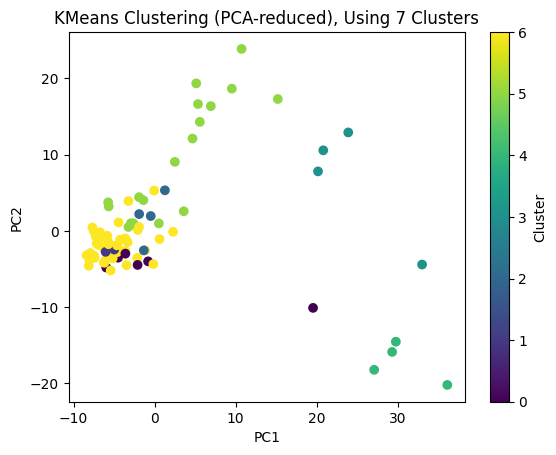

Silhouette Score: 0.0001
Overall Average pairwise correlation: -0.0001
Cluster 6 Average pairwise correlation: -0.0004 and 5.02 times overall With  51
<table border="1" class="dataframe">
  <thead>
    <tr style="text-align: right;">
      <th></th>
      <th>Code</th>
      <th>Company</th>
      <th>Market Cap</th>
      <th>Sector</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <th>9</th>
      <td>FSR SJ Equity</td>
      <td>Firstrand Limited (JSE:FSR)</td>
      <td>419646000000</td>
      <td>Financials</td>
    </tr>
    <tr>
      <th>10</th>
      <td>CPI SJ Equity</td>
      <td>Capitec Bank Holdings Limited (JSE:CPI)</td>
      <td>415417000000</td>
      <td>Financials</td>
    </tr>
    <tr>
      <th>12</th>
      <td>SBK SJ Equity</td>
      <td>Standard Bank Group (JSE:SBK)</td>
      <td>372867000000</td>
      <td>Financials</td>
    </tr>
    <tr>
      <th>13</th>
      <td>VOD SJ Equity</td>
      <td>Vodacom Group Limited (JSE:VOD)</td>
      <td>288425000000<

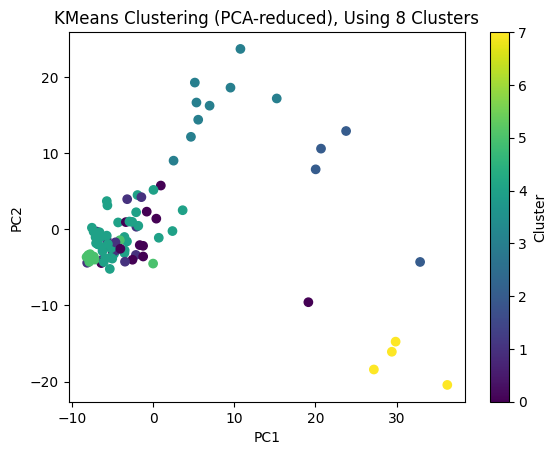

Silhouette Score: 0.0493
Overall Average pairwise correlation: -0.0001
Cluster 1 Average pairwise correlation: 0.0001 and -1.63 times overall With  13
<table border="1" class="dataframe">
  <thead>
    <tr style="text-align: right;">
      <th></th>
      <th>Code</th>
      <th>Company</th>
      <th>Market Cap</th>
      <th>Sector</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <th>20</th>
      <td>ABG SJ Equity</td>
      <td>Absa Group Limited (JSE:ABG)</td>
      <td>160630000000</td>
      <td>Financials</td>
    </tr>
    <tr>
      <th>42</th>
      <td>TBS SJ Equity</td>
      <td>Tiger Brands Limited (JSE:TBS)</td>
      <td>53817500000</td>
      <td>Consumer Goods</td>
    </tr>
    <tr>
      <th>56</th>
      <td>RDF SJ Equity</td>
      <td>Redefine Properties Limited (JSE:RDF)</td>
      <td>33708200000</td>
      <td>Financials</td>
    </tr>
    <tr>
      <th>65</th>
      <td>KRO SJ Equity</td>
      <td>Karooooo Ltd (JSE:KRO)</td>
      <td>27186400000</td>
  

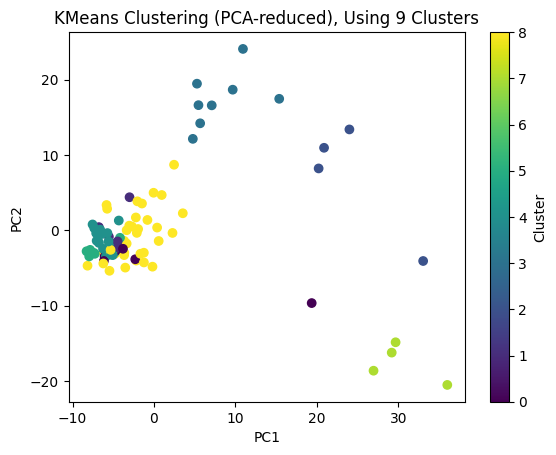

Silhouette Score: 0.0116
Overall Average pairwise correlation: -0.0001
Cluster 8 Average pairwise correlation: 0.0002 and -3.26 times overall With  37
<table border="1" class="dataframe">
  <thead>
    <tr style="text-align: right;">
      <th></th>
      <th>Code</th>
      <th>Company</th>
      <th>Market Cap</th>
      <th>Sector</th>
    </tr>
  </thead>
  <tbody>
    <tr>
      <th>0</th>
      <td>PRX SJ Equity</td>
      <td>Prosus N.V. (JSE:PRX)</td>
      <td>2287790000000</td>
      <td>Technology</td>
    </tr>
    <tr>
      <th>2</th>
      <td>ANH SJ Equity</td>
      <td>Anheuser-Busch Inbev (JSE:ANH)</td>
      <td>2201800000000</td>
      <td>Consumer Goods</td>
    </tr>
    <tr>
      <th>3</th>
      <td>BTI SJ Equity</td>
      <td>British American Tobacco (JSE:BTI)</td>
      <td>1987650000000</td>
      <td>Consumer Goods</td>
    </tr>
    <tr>
      <th>4</th>
      <td>CFR SJ Equity</td>
      <td>Compagnie Fin Richemont (JSE:CFR)</td>
      <td>1783080000000

In [116]:
alse_consitutents = pd.read_csv("companies-list.csv")
alse_consitutents["Code"] = alse_consitutents["Code"].str[4:]
alse_consitutents["Code"] = alse_consitutents["Code"] + " SJ Equity"
alse_consitutents = alse_consitutents.drop(columns=['Link', 'Last trade', 'Change', '%Change'])

for cluster_amount in range(5,10):
    cluster_averages_list = []
    kmeans = KMeans(n_clusters=cluster_amount, random_state=42) #initialise Model
    kmeans.fit(df_to_Cluster_on)# Fit Model
    df_to_Cluster_on["Cluster"] = kmeans.labels_ #ad cluster labels to df
    score = silhouette_score(df_to_Cluster_on.iloc[:,0:-1], kmeans.labels_, metric='euclidean') 
    
    pca = PCA(n_components=2)
    components = pca.fit_transform(df_to_Cluster_on)

    plt.scatter(components[:, 0], components[:, 1], c=kmeans.labels_, cmap="viridis")
    plt.title(f"KMeans Clustering (PCA-reduced), Using {cluster_amount} Clusters")
    plt.xlabel("PC1")
    plt.ylabel("PC2")
    plt.colorbar(label="Cluster")
    

    # Analyse pre and post correlation
    overall_corr_matrix = df_to_Cluster_on.iloc[:,0:-1].corr()
    upper_tri = overall_corr_matrix.where(np.triu(np.ones(overall_corr_matrix.shape), k=1).astype(bool))

    # Step 3: Compute the mean of the upper triangle
    avg_tot_corr = upper_tri.stack().mean()
    print(f"{cluster_amount} Clusters: ")
    plt.show()
    print("Silhouette Score:", round(score, 4))
    print("Overall Average pairwise correlation:", round(avg_tot_corr, 4))
    
    cluster_list = df_to_Cluster_on['Cluster'].unique().tolist()
    for cluster in cluster_list:
        cluster_df = df_to_Cluster_on[df_to_Cluster_on['Cluster'] == cluster]
        cluster_averages = cluster_df.mean()
        cluster_averages_list.append(cluster_averages)
        cluster_list = cluster_df.index.to_list()
        cluster_info = alse_consitutents[alse_consitutents["Code"].isin(cluster_list)]
        corr_matrix = cluster_df.iloc[:,0:-1].corr()
        upper_tri = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))
        avg_corr = upper_tri.stack().mean()
        print(f"Cluster {cluster} Average pairwise correlation: { round(avg_corr, 4)} and {round(avg_corr/avg_tot_corr,2)} times overall With ",cluster_df.shape[0] )
        
        print(cluster_info.to_html())
    cluster_averages_df = pd.DataFrame(cluster_averages_list)
    cluster_averages_df = cluster_averages_df
    clusters = cluster_averages_df['Cluster']
    cluster_averages_df['Cluster'] = cluster_averages_df['Cluster'].astype(int )
    cluster_averages_df = cluster_averages_df.set_index('Cluster')
    cluster_averages_df = cluster_averages_df.T
    cluster_averages_df_corr = cluster_averages_df.corr()
    cluster_upper_tri = cluster_averages_df_corr.where(np.triu(np.ones(cluster_averages_df_corr.shape), k=1).astype(bool))
    cluster_corr = cluster_upper_tri.stack().mean()
    print(f"Between Cluster Correlation: {cluster_corr}")
    


-0.10884177891631612

# Hierchcial Clustering

## Removing Market Effect

In [351]:
pca = PCA(n_components=1)
pc1 = pca.fit_transform(df_1)
df_1_demeaned = df_1 - df_1.mean(axis=0)
df_1_residuls = []
columns = df_1.columns.values.tolist()
stocks = df_1.index.to_list()

for i in range(df_1.shape[1]):
    model = LinearRegression().fit(pc1,df_1.iloc[:,i])
    fitted = model.predict(pc1)
    residuals = df_1.iloc[:,i]-fitted
    df_1_residuls.append(residuals)
    
df_1_excl_market = np.array(df_1_residuls).T

df_1_excl_market = pd.DataFrame(df_1_excl_market, columns = columns)
df_1_excl_market['Stocks'] = stocks
df_1_excl_market = df_1_excl_market.set_index(['Stocks'])
df_1_excl_market
    

,31-Dec-00,07-Jan-01,14-Jan-01,21-Jan-01,28-Jan-01,04-Feb-01,11-Feb-01,18-Feb-01,25-Feb-01,04-Mar-01,...,30-Mar-25,06-Apr-25,13-Apr-25,20-Apr-25,27-Apr-25,04-May-25,11-May-25,18-May-25,25-May-25,01-Jun-25
Stocks,,,,,,,,,,,,,,,,,,,,,
DTC SJ Equity,0.022587,-0.040739,-0.031054,0.075904,0.054236,-0.065191,-0.177493,-0.040458,-0.092152,-0.144719,...,0.059465,0.079790,-0.042502,-0.010075,-0.013807,0.029219,0.016230,0.031676,-0.028152,-0.005054
BYI SJ Equity,0.012561,-0.030711,0.029027,-0.004108,0.044518,-0.014915,-0.007686,-0.080354,-0.052008,0.025559,...,0.019492,0.060004,-0.022298,-0.000203,-0.033932,0.019095,0.046254,-0.088400,-0.037944,0.044838
KRO SJ Equity,0.002662,-0.065821,-0.046294,-0.069061,-0.021596,-0.081003,0.103075,0.069236,-0.087574,0.024461,...,-0.020615,0.039161,-0.053104,-0.049696,0.066561,-0.040416,0.006160,0.191899,-0.008767,0.015265
NPN SJ Equity,0.042526,0.059326,-0.090862,0.185876,-0.015096,0.075461,0.002050,-0.050212,-0.071813,-0.034061,...,-0.010471,0.050295,-0.092019,0.009622,0.075897,0.018926,0.006287,0.041497,-0.047659,-0.015309
PRX SJ Equity,0.027531,-0.000679,-0.025878,0.120879,-0.025152,0.025406,0.032089,-0.050233,-0.041841,-0.039117,...,-0.000476,0.040253,-0.092059,-0.020353,0.065922,0.008951,0.006282,0.031512,-0.037700,-0.015288
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
EXX SJ Equity,-0.005695,0.027538,-0.001219,0.034262,-0.011336,0.050917,-0.022102,0.064331,-0.005775,-0.008617,...,-0.000590,0.019358,-0.032916,-0.019814,0.006446,-0.000530,-0.023818,0.001829,-0.028575,0.015166
TGA SJ Equity,-0.004016,0.028358,-0.002508,0.022601,-0.005221,0.046203,-0.034511,0.058032,-0.012927,-0.013332,...,-0.040603,-0.000744,-0.083013,0.030247,0.016506,-0.030471,-0.083830,-0.008135,0.031326,0.015217
BOX SJ Equity,-0.003517,0.005365,-0.032187,0.013130,-0.022507,0.049734,-0.003552,0.035625,-0.004968,-0.005906,...,-0.020542,-0.020267,-0.022557,-0.030040,0.016227,0.019253,-0.043776,-0.058304,-0.018209,0.024976


### Training

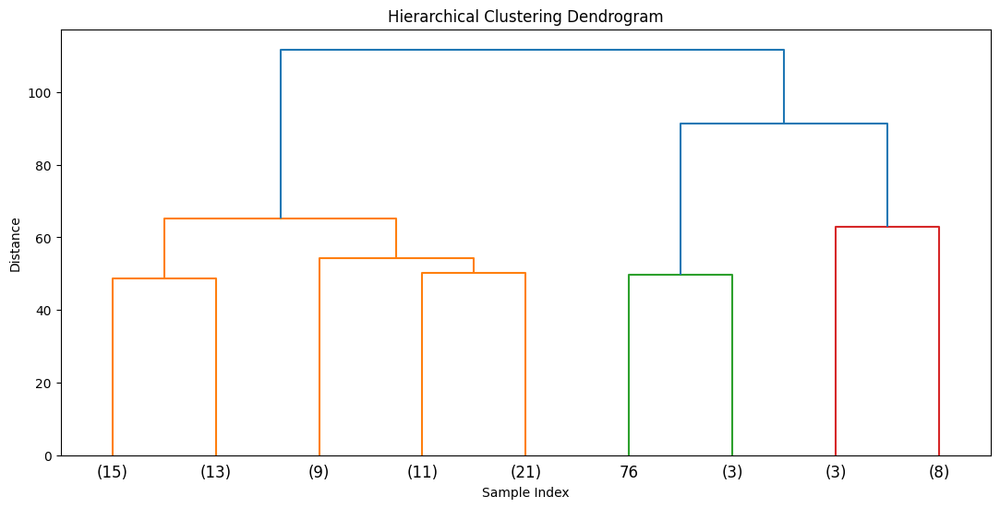

In [352]:
# Choose Period of The data
week_number_start = 500
week_number_end = 1200
df_to_Cluster_on = df_1_excl_market.iloc[:,week_number_start:week_number_end]
df_to_Cluster_on = df_to_Cluster_on.drop(['PAN SJ Equity', 'DRD SJ Equity', 'BLU SJ Equity'])
#df_to_Cluster_on = df_to_Cluster_on.drop(['ANG SJ Equity', 'DRD SJ Equity', 'GFI SJ Equity', 'HAR SJ Equity', 'PAN SJ Equity', 'SSW SJ Equity'])
stocks = df_to_Cluster_on.index 
# Remove Nan
df_to_Cluster_on = df_to_Cluster_on.dropna()
columns = df_to_Cluster_on.columns.values.tolist()
df_to_Cluster_on = df_to_Cluster_on.reset_index()
df_to_Cluster_on = df_to_Cluster_on.set_index(['Stocks'])


# Remove Outliers
"""qt = QuantileTransformer(output_distribution='normal')
df_to_Cluster_on_standardised = pd.DataFrame(qt.fit_transform(df_to_Cluster_on),
                                   index=df_to_Cluster_on.index,
                                   columns=df_to_Cluster_on.columns)"""

scaler = StandardScaler()
df_to_Cluster_on = scaler.fit_transform(df_to_Cluster_on)
df_to_Cluster_on = pd.DataFrame(df_to_Cluster_on, columns=columns)
df_to_Cluster_on['Stock'] = stocks
df_to_Cluster_on = df_to_Cluster_on.set_index(['Stock'])
df_to_Cluster_on_standardised = df_to_Cluster_on.clip(lower=-10, upper=10)
df_to_Cluster_on_standardised = df_to_Cluster_on_standardised.drop(['KRO SJ Equity', "PMR SJ Equity"])


# Create Hierchcial Model
Z = linkage(df_to_Cluster_on_standardised, method='ward') 

# Print Dendogram
plt.figure(figsize=(13, 6))
dendrogram(Z, truncate_mode='lastp', p=9)  # p: number of levels to show
plt.title("Hierarchical Clustering Dendrogram")
plt.xlabel("Sample Index")
plt.ylabel("Distance")
plt.show()


### Testing

9 Clusters


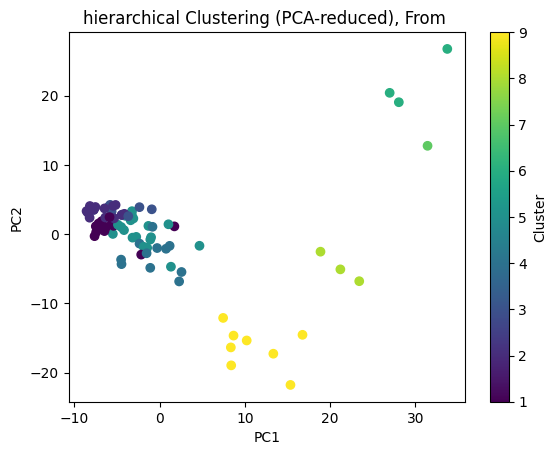

Silhouette Score: 0.0335
Overall Average pairwise correlation: -0.0001
Cluster 5 Containing 21 Stocks With Average Correlation -0.0005328212478959124
             Code                                            Company    Market Cap              Sector
13  VOD SJ Equity                    Vodacom Group Limited (JSE:VOD)  288425000000  Telecommunications
14  MTN SJ Equity                        MTN Group Limited (JSE:MTN)  256660000000  Telecommunications
21  BID SJ Equity                  Bid Corporation Limited (JSE:BID)  155313000000   Consumer Services
43  APN SJ Equity        Aspen Pharmacare Holdings Limited (JSE:APN)   52907700000         Health Care
44  MCG SJ Equity                        MultiChoice Group (JSE:MCG)   51924400000   Consumer Services
58  BOX SJ Equity                     Boxer Retail Limited (JSE:BOX)   32599400000   Consumer Services
60  N91 SJ Equity                           Ninety One plc (JSE:N91)   28178900000          Financials
62  KST SJ Equity         

In [279]:
all_cluster_info = pd.DataFrame()
for cluster_numer in [9]:
    cluster_labels = fcluster(Z, t=cluster_numer, criterion='maxclust')
    score = silhouette_score(df_to_Cluster_on_standardised.iloc[:,0:-1], cluster_labels, metric='euclidean') 
    
    df_to_Cluster_on_standardised['Cluster'] = cluster_labels
    cluster_averages_list = []
    # Reduce Dimension and plot Clusters
    pca = PCA(n_components=2)
    components = pca.fit_transform(df_to_Cluster_on_standardised)
    plt.scatter(components[:, 0], components[:, 1], c=cluster_labels, cmap="viridis")
    plt.title(f"hierarchical Clustering (PCA-reduced), From ")
    plt.xlabel("PC1")
    plt.ylabel("PC2")
    plt.colorbar(label="Cluster")
    

    # Analyse pre and post correlation
    overall_corr_matrix = df_to_Cluster_on_standardised.iloc[:,0:-1].corr()
    overall_upper_tri = overall_corr_matrix.where(np.triu(np.ones(overall_corr_matrix.shape), k=1).astype(bool))

    # Step 3: Compute the mean of the upper triangle
    overall_corr = overall_upper_tri.stack().mean()
    print(f"{cluster_numer} Clusters")
    plt.show()
    print("Silhouette Score:", round(score, 4))
    print("Overall Average pairwise correlation:", round(overall_corr, 4))

    cluster_list = df_to_Cluster_on_standardised['Cluster'].unique().tolist()
    for cluster in cluster_list:
        cluster_df = df_to_Cluster_on_standardised[df_to_Cluster_on_standardised['Cluster'] == cluster]
        
        cluster_corr = cluster_df.corr()
        cluster_averages = cluster_df.mean()
        cluster_averages_list.append(cluster_averages)
        cluster_list = cluster_df.index.to_list()
        cluster_list = cluster_df.index.to_list()
        cluster_info = alse_consitutents[alse_consitutents["Code"].isin(cluster_list)]
        corr_matrix = cluster_df.iloc[:,0:-1].corr()
        upper_tri = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))
        cluster_corr = upper_tri.stack().mean()
        print(f"Cluster {cluster} Containing {cluster_df.shape[0]} Stocks With Average Correlation {cluster_corr}" )
        print(cluster_info.to_string())
        all_cluster_info = pd.concat([all_cluster_info,cluster_info ], ignore_index=True)
    cluster_averages_df = pd.DataFrame(cluster_averages_list)
    cluster_averages_df = cluster_averages_df
    clusters = cluster_averages_df['Cluster']
    cluster_averages_df['Cluster'] = cluster_averages_df['Cluster'].astype(int )
    cluster_averages_df = cluster_averages_df.set_index('Cluster')
    cluster_averages_df = cluster_averages_df.T
    cluster_averages_df_corr = cluster_averages_df.corr()
    cluster_upper_tri = cluster_averages_df_corr.where(np.triu(np.ones(cluster_averages_df_corr.shape), k=1).astype(bool))
    cluster_corr = cluster_upper_tri.stack().mean()
    print(f"Between Cluster Correlation: {cluster_corr}")

In [221]:
all_cluster_info.to_csv('Cluster_info.csv')

In [ ]:
df_to_Cluster_on_standardised = df_to_Cluster_on_standardised.reset_index()
df_to_Cluster_on_standardised = df_to_Cluster_on_standardised.sort_values('Stock')
df_to_Cluster_on_standardised

,Stock,01-Aug-10,08-Aug-10,15-Aug-10,22-Aug-10,29-Aug-10,05-Sep-10,12-Sep-10,19-Sep-10,26-Sep-10,...,29-Oct-23,05-Nov-23,12-Nov-23,19-Nov-23,26-Nov-23,03-Dec-23,10-Dec-23,17-Dec-23,24-Dec-23,Cluster
11,ABG SJ Equity,-0.838009,-1.321596,-0.921262,0.212097,0.179709,-0.527210,-0.044937,-0.688321,0.309088,...,-0.302711,0.947490,-0.117801,-0.671214,-0.427243,-0.300422,-1.686004,-0.992388,-0.115754,1
40,ADH SJ Equity,0.726232,0.203675,0.720129,0.667652,-0.441004,-2.268788,0.869022,1.701310,-0.561853,...,0.496265,0.288074,1.870133,0.027997,0.042180,-0.295913,0.842751,-0.159681,-0.761661,5
22,AFH SJ Equity,5.848121,0.202011,-3.206432,4.172778,-2.772650,-1.222824,4.904113,-0.501034,5.298340,...,2.623905,-1.665576,-1.612289,0.506218,-3.419846,0.944663,0.846080,0.672620,1.185566,5
65,AGL SJ Equity,0.746692,-0.184197,-2.148932,0.223029,-1.064545,1.214489,-0.509486,0.140858,-0.989988,...,0.228367,-0.132601,-1.608128,1.943318,0.256284,0.730619,-3.369459,-2.934989,1.396383,9
71,ANG SJ Equity,-0.432399,2.097357,1.165644,1.158403,-0.753883,-0.884139,0.835053,-1.061959,0.312514,...,-1.101839,-2.088123,-2.354135,0.524994,0.024250,3.007839,-2.099947,0.117185,0.529564,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
38,VKE SJ Equity,0.728914,0.202692,1.551916,1.137243,-0.130420,-1.221684,0.864935,-1.109111,-0.127093,...,-0.834019,0.942195,0.626688,-0.679299,-0.651652,0.738380,0.421997,0.672670,0.103534,3
7,VOD SJ Equity,-0.450768,0.962978,-0.102315,-1.661597,0.491127,0.175886,-0.035185,-0.301299,1.175240,...,0.229895,-0.361471,0.875842,-1.624826,0.500139,-0.918906,0.211549,0.672636,-0.113453,5
18,WBC SJ Equity,-0.837655,-1.321726,-0.920761,0.212480,0.179676,-0.527428,-0.045478,-0.687468,0.309189,...,0.583947,0.078050,0.379950,-0.355225,-0.273822,0.044578,-0.558486,-0.344956,-0.115881,1
60,WBO SJ Equity,2.310921,-0.180406,2.390424,-1.188219,-0.131103,-1.226249,-0.493731,1.323228,-0.558956,...,0.229323,-0.139762,-0.366685,1.222251,-1.118750,1.563505,-0.629352,-0.714907,0.317401,5


In [291]:
df_after_hierc = df_1[df_1.index.isin(df_to_Cluster_on_standardised['Stock'].tolist())]
df_after_hierc = df_after_hierc.reset_index()
df_after_hierc = df_after_hierc.sort_values('index')
df_after_hierc["Cluster"] = df_to_Cluster_on_standardised['Cluster']
df_after_hierc = df_after_hierc.set_index('index')
df_after_hierc

Current,31-Dec-00,07-Jan-01,14-Jan-01,21-Jan-01,28-Jan-01,04-Feb-01,11-Feb-01,18-Feb-01,25-Feb-01,04-Mar-01,...,06-Apr-25,13-Apr-25,20-Apr-25,27-Apr-25,04-May-25,11-May-25,18-May-25,25-May-25,01-Jun-25,Cluster
index,,,,,,,,,,,,,,,,,,,,,
ABG SJ Equity,0.010,0.0400,0.000,0.030,0.0400,0.0300,-0.10,0.080,0.0000,0.0000,...,-0.12,0.01,0.07,0.03,0.02,-0.03,0.03,-0.02,0.04,1
ADH SJ Equity,0.000,0.0400,0.310,-0.050,0.1900,-0.0500,0.05,0.370,0.0000,-0.0200,...,-0.06,0.02,0.02,0.00,0.00,-0.01,0.03,0.00,0.01,5
AFH SJ Equity,0.005,0.0025,-0.010,0.015,0.0225,-0.0425,-0.12,-0.025,-0.0475,0.0225,...,-0.08,-0.03,0.01,0.05,0.10,0.08,-0.01,0.01,0.00,5
AGL SJ Equity,0.000,0.0700,0.030,0.080,-0.0300,0.1000,-0.05,0.100,-0.0100,-0.0400,...,-0.15,0.08,0.02,0.07,-0.02,-0.04,-0.01,0.07,0.01,9
ANG SJ Equity,-0.040,-0.0100,0.000,0.000,0.0200,-0.0600,0.03,0.000,0.1100,0.0500,...,-0.06,0.26,0.01,-0.09,-0.01,0.10,-0.11,0.10,-0.02,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
VKE SJ Equity,-0.010,0.0200,-0.005,0.000,0.0150,0.0050,-0.01,0.010,0.0000,0.0300,...,-0.02,0.05,0.06,-0.02,0.05,0.01,0.02,-0.03,0.04,3
VOD SJ Equity,0.030,-0.0150,0.085,0.015,-0.0050,-0.0350,0.05,-0.055,0.0800,-0.0450,...,-0.05,0.05,0.06,0.04,0.03,-0.03,0.00,0.03,0.01,5
WBC SJ Equity,0.010,0.0400,0.000,0.030,0.0400,0.0300,-0.10,0.080,0.0000,0.0000,...,-0.14,0.06,0.00,0.12,0.02,0.01,0.03,0.01,0.04,1


In [353]:
df_1

Current,31-Dec-00,07-Jan-01,14-Jan-01,21-Jan-01,28-Jan-01,04-Feb-01,11-Feb-01,18-Feb-01,25-Feb-01,04-Mar-01,...,30-Mar-25,06-Apr-25,13-Apr-25,20-Apr-25,27-Apr-25,04-May-25,11-May-25,18-May-25,25-May-25,01-Jun-25
DTC SJ Equity,0.040000,-0.030000,0.000000,0.090000,0.070000,-0.060000,-0.200000,-0.030000,-0.110000,-0.150000,...,0.06,-0.01,0.02,0.03,0.00,0.05,0.01,0.04,-0.01,0.01
BYI SJ Equity,0.030000,-0.020000,0.060000,0.010000,0.060000,-0.010000,-0.030000,-0.070000,-0.070000,0.020000,...,0.02,-0.03,0.04,0.04,-0.02,0.04,0.04,-0.08,-0.02,0.06
KRO SJ Equity,0.020000,-0.055000,-0.015000,-0.055000,-0.005000,-0.075000,0.080000,0.080000,-0.105000,0.020000,...,-0.02,-0.05,0.01,-0.01,0.08,-0.02,0.00,0.20,0.01,0.03
NPN SJ Equity,0.060000,0.070000,-0.060000,0.200000,0.000000,0.080000,-0.020000,-0.040000,-0.090000,-0.040000,...,-0.01,-0.04,-0.03,0.05,0.09,0.04,0.00,0.05,-0.03,0.00
PRX SJ Equity,0.045000,0.010000,0.005000,0.135000,-0.010000,0.030000,0.010000,-0.040000,-0.060000,-0.045000,...,0.00,-0.05,-0.03,0.02,0.08,0.03,0.00,0.04,-0.02,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
EXX SJ Equity,0.011667,0.038333,0.030000,0.048333,0.005000,0.056667,-0.045000,0.075000,-0.023333,-0.013333,...,0.00,-0.07,0.03,0.02,0.02,0.02,-0.03,0.01,-0.01,0.03
TGA SJ Equity,0.013333,0.039167,0.028750,0.036667,0.011250,0.052083,-0.057500,0.068750,-0.030417,-0.017917,...,-0.04,-0.09,-0.02,0.07,0.03,-0.01,-0.09,0.00,0.05,0.03
BOX SJ Equity,0.013889,0.016111,-0.001111,0.027222,-0.006667,0.055000,-0.026111,0.046111,-0.022778,-0.011111,...,-0.02,-0.11,0.04,0.01,0.03,0.04,-0.05,-0.05,0.00,0.04
SRI SJ Equity,0.020000,0.025000,0.015000,-0.005000,0.035000,-0.010000,0.000000,0.020000,-0.045000,-0.010000,...,-0.03,-0.01,0.07,0.02,0.06,-0.04,-0.04,0.04,-0.05,0.02


In [356]:
df_1_sorted = df_1.sort_index()
df_1_sorted

Current,31-Dec-00,07-Jan-01,14-Jan-01,21-Jan-01,28-Jan-01,04-Feb-01,11-Feb-01,18-Feb-01,25-Feb-01,04-Mar-01,...,30-Mar-25,06-Apr-25,13-Apr-25,20-Apr-25,27-Apr-25,04-May-25,11-May-25,18-May-25,25-May-25,01-Jun-25
ABG SJ Equity,0.010,0.0400,0.000,0.030,0.0400,0.0300,-0.10,0.080,0.0000,0.0000,...,-0.03,-0.12,0.01,0.07,0.03,0.02,-0.03,0.03,-0.02,0.04
ADH SJ Equity,0.000,0.0400,0.310,-0.050,0.1900,-0.0500,0.05,0.370,0.0000,-0.0200,...,0.04,-0.06,0.02,0.02,0.00,0.00,-0.01,0.03,0.00,0.01
AFH SJ Equity,0.005,0.0025,-0.010,0.015,0.0225,-0.0425,-0.12,-0.025,-0.0475,0.0225,...,-0.04,-0.08,-0.03,0.01,0.05,0.10,0.08,-0.01,0.01,0.00
AGL SJ Equity,0.000,0.0700,0.030,0.080,-0.0300,0.1000,-0.05,0.100,-0.0100,-0.0400,...,-0.04,-0.15,0.08,0.02,0.07,-0.02,-0.04,-0.01,0.07,0.01
ANG SJ Equity,-0.040,-0.0100,0.000,0.000,0.0200,-0.0600,0.03,0.000,0.1100,0.0500,...,0.03,-0.06,0.26,0.01,-0.09,-0.01,0.10,-0.11,0.10,-0.02
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
VKE SJ Equity,-0.010,0.0200,-0.005,0.000,0.0150,0.0050,-0.01,0.010,0.0000,0.0300,...,-0.02,-0.02,0.05,0.06,-0.02,0.05,0.01,0.02,-0.03,0.04
VOD SJ Equity,0.030,-0.0150,0.085,0.015,-0.0050,-0.0350,0.05,-0.055,0.0800,-0.0450,...,0.05,-0.05,0.05,0.06,0.04,0.03,-0.03,0.00,0.03,0.01
WBC SJ Equity,0.010,0.0400,0.000,0.030,0.0400,0.0300,-0.10,0.080,0.0000,0.0000,...,0.03,-0.14,0.06,0.00,0.12,0.02,0.01,0.03,0.01,0.04
WBO SJ Equity,-0.020,-0.0200,0.010,0.020,0.0400,0.1200,-0.11,-0.030,0.0600,0.1100,...,0.00,-0.12,0.09,0.01,0.08,0.00,-0.03,0.00,-0.03,-0.01


In [292]:
df_after_hierc.to_csv('Cluster_and_returns.csv')

In [355]:
df_after_hierc

Current,31-Dec-00,07-Jan-01,14-Jan-01,21-Jan-01,28-Jan-01,04-Feb-01,11-Feb-01,18-Feb-01,25-Feb-01,04-Mar-01,...,06-Apr-25,13-Apr-25,20-Apr-25,27-Apr-25,04-May-25,11-May-25,18-May-25,25-May-25,01-Jun-25,Cluster
index,,,,,,,,,,,,,,,,,,,,,
ABG SJ Equity,0.010,0.0400,0.000,0.030,0.0400,0.0300,-0.10,0.080,0.0000,0.0000,...,-0.12,0.01,0.07,0.03,0.02,-0.03,0.03,-0.02,0.04,1
ADH SJ Equity,0.000,0.0400,0.310,-0.050,0.1900,-0.0500,0.05,0.370,0.0000,-0.0200,...,-0.06,0.02,0.02,0.00,0.00,-0.01,0.03,0.00,0.01,5
AFH SJ Equity,0.005,0.0025,-0.010,0.015,0.0225,-0.0425,-0.12,-0.025,-0.0475,0.0225,...,-0.08,-0.03,0.01,0.05,0.10,0.08,-0.01,0.01,0.00,5
AGL SJ Equity,0.000,0.0700,0.030,0.080,-0.0300,0.1000,-0.05,0.100,-0.0100,-0.0400,...,-0.15,0.08,0.02,0.07,-0.02,-0.04,-0.01,0.07,0.01,9
ANG SJ Equity,-0.040,-0.0100,0.000,0.000,0.0200,-0.0600,0.03,0.000,0.1100,0.0500,...,-0.06,0.26,0.01,-0.09,-0.01,0.10,-0.11,0.10,-0.02,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
VKE SJ Equity,-0.010,0.0200,-0.005,0.000,0.0150,0.0050,-0.01,0.010,0.0000,0.0300,...,-0.02,0.05,0.06,-0.02,0.05,0.01,0.02,-0.03,0.04,3
VOD SJ Equity,0.030,-0.0150,0.085,0.015,-0.0050,-0.0350,0.05,-0.055,0.0800,-0.0450,...,-0.05,0.05,0.06,0.04,0.03,-0.03,0.00,0.03,0.01,5
WBC SJ Equity,0.010,0.0400,0.000,0.030,0.0400,0.0300,-0.10,0.080,0.0000,0.0000,...,-0.14,0.06,0.00,0.12,0.02,0.01,0.03,0.01,0.04,1


# DB Scan

## Train

In [14]:
pca = PCA(n_components=1)
pc1 = pca.fit_transform(df_1)
df_1_demeaned = df_1 - df_1.mean(axis=0)
df_1_residuls = []
columns = df_1.columns.values.tolist()
stocks = df_1.index.to_list()

for i in range(df_1.shape[1]):
    model = LinearRegression().fit(pc1,df_1.iloc[:,i])
    fitted = model.predict(pc1)
    residuals = df_1.iloc[:,i]-fitted
    df_1_residuls.append(residuals)
    
df_1_excl_market = np.array(df_1_residuls).T

df_1_excl_market = pd.DataFrame(df_1_excl_market, columns = columns)
df_1_excl_market['Stocks'] = stocks
df_1_excl_market = df_1_excl_market.set_index(['Stocks'])
df_1_excl_market
# Choose Period of The data
week_number_start = 500
week_number_end = 1200
df_to_Cluster_on = df_1_excl_market.iloc[:,week_number_start:week_number_end]

#df_to_Cluster_on = df_to_Cluster_on.drop(['ANG SJ Equity', 'DRD SJ Equity', 'GFI SJ Equity', 'HAR SJ Equity', 'PAN SJ Equity', 'SSW SJ Equity'])
stocks = df_to_Cluster_on.index 
# Remove Nan
df_to_Cluster_on = df_to_Cluster_on.dropna()
columns = df_to_Cluster_on.columns.values.tolist()
df_to_Cluster_on = df_to_Cluster_on.reset_index()
df_to_Cluster_on = df_to_Cluster_on.set_index(['Stocks'])
df_to_Cluster_on

,01-Aug-10,08-Aug-10,15-Aug-10,22-Aug-10,29-Aug-10,05-Sep-10,12-Sep-10,19-Sep-10,26-Sep-10,03-Oct-10,...,22-Oct-23,29-Oct-23,05-Nov-23,12-Nov-23,19-Nov-23,26-Nov-23,03-Dec-23,10-Dec-23,17-Dec-23,24-Dec-23
Stocks,,,,,,,,,,,,,,,,,,,,,
DTC SJ Equity,0.039130,-0.007434,-0.053180,-0.000818,0.036472,-0.028205,-0.014307,-0.045861,0.031412,-0.011008,...,-0.059619,-0.000273,0.044455,-0.049765,-0.011732,-0.040955,-0.028333,0.033602,0.050735,0.048440
PBG SJ Equity,-0.000866,0.201716,-0.153230,0.007760,-0.003045,0.371884,-0.144283,0.144823,-0.298559,0.179051,...,0.070546,-0.030198,0.004350,-0.049630,-0.011756,-0.020911,0.021671,-0.066373,-0.029156,-0.011415
AEL SJ Equity,0.019134,-0.008201,-0.023225,0.007898,0.036908,0.011876,-0.014285,-0.025243,0.001438,0.029046,...,0.030530,-0.040205,0.074360,-0.019643,0.178246,-0.040915,0.041670,0.023625,-0.049166,-0.031429
EOH SJ Equity,0.016915,-0.013399,-0.016047,-0.005585,0.001225,0.001954,-0.007597,-0.022971,0.008686,0.015210,...,-0.023768,-0.005139,0.032601,0.014365,0.003225,0.003568,-0.011660,-0.015242,0.016486,-0.002967
BYI SJ Equity,-0.000869,0.042455,0.021814,-0.006004,-0.003465,-0.053193,-0.004304,-0.020771,-0.013584,-0.031000,...,0.000403,0.019736,0.004441,0.050253,0.028265,0.009051,0.061668,-0.016394,0.050749,-0.011541
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
MCZ SJ Equity,-0.150868,0.012105,-0.173207,0.018411,-0.033266,0.081844,-0.074294,0.144510,-0.038572,-0.180976,...,-0.049530,-0.000233,0.054398,0.050308,-0.061745,-0.010931,0.001669,-0.016384,-0.109206,0.068519
TGA SJ Equity,-0.000864,-0.013552,-0.010746,-0.023940,-0.021642,0.043162,-0.007400,-0.002461,-0.011675,-0.004055,...,-0.009402,0.029826,-0.105683,-0.059588,-0.031764,-0.010897,-0.048328,0.023635,-0.019121,-0.001369
BOX SJ Equity,0.002466,-0.000096,-0.019317,-0.000999,-0.003278,0.009619,-0.004294,-0.008840,-0.020240,-0.010422,...,-0.076200,0.009766,-0.012266,-0.013028,-0.005078,0.025734,-0.024998,-0.053051,-0.055875,0.021848


/opt/anaconda3/envs/dataAnalysis/lib/python3.12/site-packages/sklearn/preprocessing/_data.py:2762: UserWarning: n_quantiles (1000) is greater than the total number of samples (175). n_quantiles is set to n_samples.
  warnings.warn(


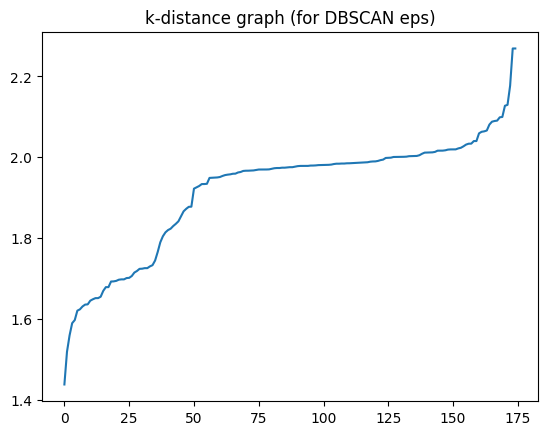

In [15]:
qt = QuantileTransformer(output_distribution='normal')
df_to_Cluster_on = pd.DataFrame(qt.fit_transform(df_to_Cluster_on),
                                   index=df_to_Cluster_on.index,
                                   columns=df_to_Cluster_on.columns)
df_DBSCan = df_to_Cluster_on.T
corr = df_DBSCan.corr()
dist = np.sqrt(2 * (1 - corr))
dist
from sklearn.neighbors import NearestNeighbors
import matplotlib.pyplot as plt

nn = NearestNeighbors(n_neighbors=5)
nn.fit(dist)
dists, _ = nn.kneighbors(dist)
k_distances = np.sort(dists[:, 4])  

plt.plot(k_distances)
plt.title("k-distance graph (for DBSCAN eps)")
plt.show()

## Test

In [17]:
for sample_num in range(2,8):
    print(f"{sample_num} samples")
    model = DBSCAN(eps=5, min_samples=3, metric='precomputed')
    labels = model.fit(dist)
    df_to_Cluster_on = df_1
    df_to_Cluster_on["Cluster"] = model.labels_

    overall_corr_matrix = df_to_Cluster_on.iloc[:,0:-1]
    upper_tri = overall_corr_matrix.where(np.triu(np.ones(overall_corr_matrix.shape), k=1).astype(bool))

    # Step 3: Compute the mean of the upper triangle
    avg_tot_corr = upper_tri.stack().mean()
    print("Overall Average pairwise correlation:", round(avg_tot_corr, 4))
    cluster_list = df_to_Cluster_on['Cluster'].unique().tolist()
    for cluster in cluster_list:
        cluster_df = df_to_Cluster_on[df_to_Cluster_on['Cluster'] == cluster]
        corr_matrix = cluster_df.corr()
        upper_tri = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))
        avg_corr = upper_tri.stack().mean()
        print(f"Cluster {cluster} Average pairwise correlation: { round(avg_corr, 4)} and {round(avg_corr/avg_tot_corr,2)} times overall" )

2 samples
Overall Average pairwise correlation: 0.0038
Cluster 0 Average pairwise correlation: -0.0001 and -0.02 times overall
3 samples
Overall Average pairwise correlation: 0.0038
Cluster 0 Average pairwise correlation: -0.0001 and -0.02 times overall
4 samples
Overall Average pairwise correlation: 0.0038
Cluster 0 Average pairwise correlation: -0.0001 and -0.02 times overall
5 samples
Overall Average pairwise correlation: 0.0038
Cluster 0 Average pairwise correlation: -0.0001 and -0.02 times overall
6 samples
Overall Average pairwise correlation: 0.0038
Cluster 0 Average pairwise correlation: -0.0001 and -0.02 times overall
7 samples
Overall Average pairwise correlation: 0.0038
Cluster 0 Average pairwise correlation: -0.0001 and -0.02 times overall


# Benchmark (Using Industries instead of Clustering)

In [322]:
compaanies_df = pd.read_csv("companies-list.csv")
compaanies_df["Code"] = compaanies_df["Code"].str[4:]
compaanies_df["Code"] = compaanies_df["Code"] + " SJ Equity"
compaanies_df = compaanies_df.drop(columns=['Company', 'Link','Market Cap', 'Last trade', 'Change', '%Change'])
compaanies_df = compaanies_df.set_index(['Code'])
compaanies_df = compaanies_df.sort_index(ascending=False)
compaanies_df = compaanies_df.rename(columns={'Sector': "Cluster"})
compaanies_df

,Cluster
Code,
ZZD SJ Equity,Consumer Goods
ZED SJ Equity,Financials
YYLBEE SJ Equity,Financials
YRK SJ Equity,Basic Materials
WSL SJ Equity,Basic Materials
...,...
ACT SJ Equity,Health Care
ACS SJ Equity,Financials
ACL SJ Equity,Basic Materials


In [323]:
df_2 = df_1[df_1.index.isin(compaanies_df.index.to_list())]
df_2 = df_2.sort_index(ascending=False)
df_2

Current,31-Dec-00,07-Jan-01,14-Jan-01,21-Jan-01,28-Jan-01,04-Feb-01,11-Feb-01,18-Feb-01,25-Feb-01,04-Mar-01,...,30-Mar-25,06-Apr-25,13-Apr-25,20-Apr-25,27-Apr-25,04-May-25,11-May-25,18-May-25,25-May-25,01-Jun-25
WHL SJ Equity,0.020,0.1000,0.140,0.000,0.0100,0.0100,-0.09,0.000,-0.0600,0.0000,...,-0.02,-0.07,0.06,0.09,0.01,0.03,-0.03,0.01,0.00,0.02
WBO SJ Equity,-0.020,-0.0200,0.010,0.020,0.0400,0.1200,-0.11,-0.030,0.0600,0.1100,...,0.00,-0.12,0.09,0.01,0.08,0.00,-0.03,0.00,-0.03,-0.01
WBC SJ Equity,0.010,0.0400,0.000,0.030,0.0400,0.0300,-0.10,0.080,0.0000,0.0000,...,0.03,-0.14,0.06,0.00,0.12,0.02,0.01,0.03,0.01,0.04
VOD SJ Equity,0.030,-0.0150,0.085,0.015,-0.0050,-0.0350,0.05,-0.055,0.0800,-0.0450,...,0.05,-0.05,0.05,0.06,0.04,0.03,-0.03,0.00,0.03,0.01
VKE SJ Equity,-0.010,0.0200,-0.005,0.000,0.0150,0.0050,-0.01,0.010,0.0000,0.0300,...,-0.02,-0.02,0.05,0.06,-0.02,0.05,0.01,0.02,-0.03,0.04
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ANG SJ Equity,-0.040,-0.0100,0.000,0.000,0.0200,-0.0600,0.03,0.000,0.1100,0.0500,...,0.03,-0.06,0.26,0.01,-0.09,-0.01,0.10,-0.11,0.10,-0.02
AGL SJ Equity,0.000,0.0700,0.030,0.080,-0.0300,0.1000,-0.05,0.100,-0.0100,-0.0400,...,-0.04,-0.15,0.08,0.02,0.07,-0.02,-0.04,-0.01,0.07,0.01
AFH SJ Equity,0.005,0.0025,-0.010,0.015,0.0225,-0.0425,-0.12,-0.025,-0.0475,0.0225,...,-0.04,-0.08,-0.03,0.01,0.05,0.10,0.08,-0.01,0.01,0.00
ADH SJ Equity,0.000,0.0400,0.310,-0.050,0.1900,-0.0500,0.05,0.370,0.0000,-0.0200,...,0.04,-0.06,0.02,0.02,0.00,0.00,-0.01,0.03,0.00,0.01


In [324]:
compaanies_df = compaanies_df[compaanies_df.index.isin(df_2.index.to_list())]
compaanies_df = compaanies_df.sort_index(ascending=False)
compaanies_df

,Cluster
Code,
WHL SJ Equity,Consumer Services
WBO SJ Equity,Industrials
WBC SJ Equity,Technology
VOD SJ Equity,Telecommunications
VKE SJ Equity,Financials
...,...
ANG SJ Equity,Basic Materials
AGL SJ Equity,Basic Materials
AFH SJ Equity,Financials


In [325]:
pca = PCA(n_components=1)
pc1 = pca.fit_transform(df_2)
df_2_demeaned = df_2 - df_2.mean(axis=0)
df_2_residuls = []
columns = df_2.columns.values.tolist()
stocks = df_2.index.to_list()

for i in range(df_2.shape[1]):
    model = LinearRegression().fit(pc1,df_2.iloc[:,i])
    fitted = model.predict(pc1)
    residuals = df_2.iloc[:,i]-fitted
    df_2_residuls.append(residuals)
    
df_2_excl_market = np.array(df_2_residuls).T

df_2_excl_market = pd.DataFrame(df_2_excl_market, columns = columns)
df_2_excl_market['Stocks'] = stocks
df_2_excl_market = df_2_excl_market.set_index(['Stocks'])
df_2_excl_market = df_2_excl_market.iloc[:,500:]
df_2_excl_market

,01-Aug-10,08-Aug-10,15-Aug-10,22-Aug-10,29-Aug-10,05-Sep-10,12-Sep-10,19-Sep-10,26-Sep-10,03-Oct-10,...,30-Mar-25,06-Apr-25,13-Apr-25,20-Apr-25,27-Apr-25,04-May-25,11-May-25,18-May-25,25-May-25,01-Jun-25
Stocks,,,,,,,,,,,,,,,,,,,,,
WHL SJ Equity,0.029244,-0.054542,0.017047,-0.036544,0.034736,0.003351,0.018907,-0.043111,0.008011,0.038554,...,-0.020440,0.020539,-0.001786,0.049476,-0.004245,0.008785,-0.023686,0.001410,-0.017421,0.004567
WBO SJ Equity,0.059648,-0.004695,0.057591,-0.026175,-0.005312,-0.036929,-0.011634,0.027841,-0.011884,0.018936,...,-0.000578,-0.030547,0.027175,-0.029871,0.066391,-0.020585,-0.023808,-0.008205,-0.048483,-0.024883
WBC SJ Equity,-0.020337,-0.034701,-0.022390,0.003838,0.004687,-0.016938,-0.001653,-0.022125,0.008120,-0.001051,...,0.029417,-0.050586,-0.002861,-0.039848,0.106413,-0.000563,0.016188,0.021809,-0.008520,0.025137
VOD SJ Equity,-0.010509,0.025364,-0.002620,-0.036318,0.014707,0.003180,-0.001424,-0.012529,0.028076,0.028787,...,0.049476,0.039875,-0.012421,0.019875,0.026144,0.009170,-0.023761,-0.008354,0.011930,-0.005096
VKE SJ Equity,0.019459,0.005376,0.037337,0.023653,-0.005290,-0.036798,0.018618,-0.032603,-0.001933,-0.011243,...,-0.020514,0.069960,-0.012340,0.019824,-0.033906,0.029121,0.016249,0.011616,-0.047987,0.024861
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ANG SJ Equity,-0.010042,0.055187,0.028007,0.024106,-0.025348,-0.027142,0.017953,-0.031432,0.008197,-0.010772,...,0.029317,0.028623,0.196381,-0.029372,-0.103123,-0.030103,0.106099,-0.117910,0.080706,-0.034462
AGL SJ Equity,0.019911,-0.004795,-0.052056,0.004064,-0.035342,0.032890,-0.011985,-0.001541,-0.021815,-0.020816,...,-0.040668,-0.061252,0.016501,-0.019448,0.056803,-0.040176,-0.033887,-0.017955,0.050828,-0.004525
AFH SJ Equity,0.149507,0.005359,-0.077599,0.088696,-0.090295,-0.036831,0.108556,-0.017492,0.123080,0.043802,...,-0.040530,0.009833,-0.092461,-0.030100,0.036168,0.079194,0.086235,-0.018339,-0.008111,-0.015075


In [326]:
columns = df_2.columns.values.tolist()
scaler = StandardScaler()
df_2_standardised = scaler.fit_transform(df_2)
df_2_standardised = pd.DataFrame(df_2_standardised, columns=columns)
df_2_standardised['Stock'] = stocks
df_2_standardised = df_2_standardised.set_index(['Stock'])
df_2_standardised = df_2_standardised.clip(lower=-10, upper=10)
df_2_standardised

,31-Dec-00,07-Jan-01,14-Jan-01,21-Jan-01,28-Jan-01,04-Feb-01,11-Feb-01,18-Feb-01,25-Feb-01,04-Mar-01,...,30-Mar-25,06-Apr-25,13-Apr-25,20-Apr-25,27-Apr-25,04-May-25,11-May-25,18-May-25,25-May-25,01-Jun-25
Stock,,,,,,,,,,,,,,,,,,,,,
WHL SJ Equity,0.080161,2.129169,1.950118,-0.301680,-0.092892,0.141628,-1.299154,-0.160184,-0.773186,0.152346,...,-0.639924,0.373322,-0.013387,1.491542,-0.078211,0.281860,-0.672849,0.022920,-0.239076,0.107965
WBO SJ Equity,-1.255789,-0.726758,-0.364253,0.123753,0.659636,2.425559,-1.676259,-0.655657,1.483938,2.444460,...,-0.010606,-0.501037,0.383773,-0.944187,1.081924,-0.735122,-0.672849,-0.181067,-0.670381,-0.671133
WBC SJ Equity,-0.253826,0.701205,-0.542281,0.336469,0.659636,0.556888,-1.487706,1.161079,0.355376,0.152346,...,0.933369,-0.850781,-0.013387,-1.248653,1.744858,-0.057134,0.467790,0.430894,-0.095307,0.627364
VOD SJ Equity,0.414149,-0.607761,0.970961,0.017394,-0.469156,-0.792708,1.340583,-1.068552,1.860125,-0.785337,...,1.562686,0.723066,-0.145774,0.578144,0.418989,0.281860,-0.672849,-0.181067,0.192230,-0.151734
VKE SJ Equity,-0.921802,0.225218,-0.631296,-0.301680,0.032530,0.037813,0.209268,0.004974,0.355376,0.777468,...,-0.639924,1.247681,-0.145774,0.578144,-0.575412,0.959849,0.467790,0.226907,-0.670381,0.627364
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ANG SJ Equity,-1.923765,-0.488764,-0.542281,-0.301680,0.157951,-1.311783,0.963478,-0.160184,2.424406,1.194216,...,0.933369,0.548194,2.634349,-0.944187,-1.735547,-1.074116,3.034228,-2.424922,1.198609,-0.930833
AGL SJ Equity,-0.587814,1.415187,-0.008196,1.400051,-1.096262,2.010299,-0.544943,1.491395,0.167282,-0.681150,...,-1.269241,-1.025653,0.251386,-0.639721,0.916190,-1.413110,-0.958009,-0.385054,0.767304,-0.151734
AFH SJ Equity,-0.420820,-0.191272,-0.720310,0.017394,0.220662,-0.948430,-1.864811,-0.573078,-0.538069,0.621187,...,-1.269241,0.198450,-1.204869,-0.944187,0.584723,2.654819,2.463908,-0.385054,-0.095307,-0.411434


In [327]:
df_2_standardised["Cluster"] = compaanies_df["Cluster"]
df_2_standardised

,31-Dec-00,07-Jan-01,14-Jan-01,21-Jan-01,28-Jan-01,04-Feb-01,11-Feb-01,18-Feb-01,25-Feb-01,04-Mar-01,...,06-Apr-25,13-Apr-25,20-Apr-25,27-Apr-25,04-May-25,11-May-25,18-May-25,25-May-25,01-Jun-25,Cluster
Stock,,,,,,,,,,,,,,,,,,,,,
WHL SJ Equity,0.080161,2.129169,1.950118,-0.301680,-0.092892,0.141628,-1.299154,-0.160184,-0.773186,0.152346,...,0.373322,-0.013387,1.491542,-0.078211,0.281860,-0.672849,0.022920,-0.239076,0.107965,Consumer Services
WBO SJ Equity,-1.255789,-0.726758,-0.364253,0.123753,0.659636,2.425559,-1.676259,-0.655657,1.483938,2.444460,...,-0.501037,0.383773,-0.944187,1.081924,-0.735122,-0.672849,-0.181067,-0.670381,-0.671133,Industrials
WBC SJ Equity,-0.253826,0.701205,-0.542281,0.336469,0.659636,0.556888,-1.487706,1.161079,0.355376,0.152346,...,-0.850781,-0.013387,-1.248653,1.744858,-0.057134,0.467790,0.430894,-0.095307,0.627364,Technology
VOD SJ Equity,0.414149,-0.607761,0.970961,0.017394,-0.469156,-0.792708,1.340583,-1.068552,1.860125,-0.785337,...,0.723066,-0.145774,0.578144,0.418989,0.281860,-0.672849,-0.181067,0.192230,-0.151734,Telecommunications
VKE SJ Equity,-0.921802,0.225218,-0.631296,-0.301680,0.032530,0.037813,0.209268,0.004974,0.355376,0.777468,...,1.247681,-0.145774,0.578144,-0.575412,0.959849,0.467790,0.226907,-0.670381,0.627364,Financials
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ANG SJ Equity,-1.923765,-0.488764,-0.542281,-0.301680,0.157951,-1.311783,0.963478,-0.160184,2.424406,1.194216,...,0.548194,2.634349,-0.944187,-1.735547,-1.074116,3.034228,-2.424922,1.198609,-0.930833,Basic Materials
AGL SJ Equity,-0.587814,1.415187,-0.008196,1.400051,-1.096262,2.010299,-0.544943,1.491395,0.167282,-0.681150,...,-1.025653,0.251386,-0.639721,0.916190,-1.413110,-0.958009,-0.385054,0.767304,-0.151734,Basic Materials
AFH SJ Equity,-0.420820,-0.191272,-0.720310,0.017394,0.220662,-0.948430,-1.864811,-0.573078,-0.538069,0.621187,...,0.198450,-1.204869,-0.944187,0.584723,2.654819,2.463908,-0.385054,-0.095307,-0.411434,Financials


In [328]:
df_2_standardised['Cluster Encoding'] = df_2_standardised['Cluster'].astype('category').cat.codes
df_2_standardised

,31-Dec-00,07-Jan-01,14-Jan-01,21-Jan-01,28-Jan-01,04-Feb-01,11-Feb-01,18-Feb-01,25-Feb-01,04-Mar-01,...,13-Apr-25,20-Apr-25,27-Apr-25,04-May-25,11-May-25,18-May-25,25-May-25,01-Jun-25,Cluster,Cluster Encoding
Stock,,,,,,,,,,,,,,,,,,,,,
WHL SJ Equity,0.080161,2.129169,1.950118,-0.301680,-0.092892,0.141628,-1.299154,-0.160184,-0.773186,0.152346,...,-0.013387,1.491542,-0.078211,0.281860,-0.672849,0.022920,-0.239076,0.107965,Consumer Services,2
WBO SJ Equity,-1.255789,-0.726758,-0.364253,0.123753,0.659636,2.425559,-1.676259,-0.655657,1.483938,2.444460,...,0.383773,-0.944187,1.081924,-0.735122,-0.672849,-0.181067,-0.670381,-0.671133,Industrials,5
WBC SJ Equity,-0.253826,0.701205,-0.542281,0.336469,0.659636,0.556888,-1.487706,1.161079,0.355376,0.152346,...,-0.013387,-1.248653,1.744858,-0.057134,0.467790,0.430894,-0.095307,0.627364,Technology,6
VOD SJ Equity,0.414149,-0.607761,0.970961,0.017394,-0.469156,-0.792708,1.340583,-1.068552,1.860125,-0.785337,...,-0.145774,0.578144,0.418989,0.281860,-0.672849,-0.181067,0.192230,-0.151734,Telecommunications,7
VKE SJ Equity,-0.921802,0.225218,-0.631296,-0.301680,0.032530,0.037813,0.209268,0.004974,0.355376,0.777468,...,-0.145774,0.578144,-0.575412,0.959849,0.467790,0.226907,-0.670381,0.627364,Financials,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ANG SJ Equity,-1.923765,-0.488764,-0.542281,-0.301680,0.157951,-1.311783,0.963478,-0.160184,2.424406,1.194216,...,2.634349,-0.944187,-1.735547,-1.074116,3.034228,-2.424922,1.198609,-0.930833,Basic Materials,0
AGL SJ Equity,-0.587814,1.415187,-0.008196,1.400051,-1.096262,2.010299,-0.544943,1.491395,0.167282,-0.681150,...,0.251386,-0.639721,0.916190,-1.413110,-0.958009,-0.385054,0.767304,-0.151734,Basic Materials,0
AFH SJ Equity,-0.420820,-0.191272,-0.720310,0.017394,0.220662,-0.948430,-1.864811,-0.573078,-0.538069,0.621187,...,-1.204869,-0.944187,0.584723,2.654819,2.463908,-0.385054,-0.095307,-0.411434,Financials,3


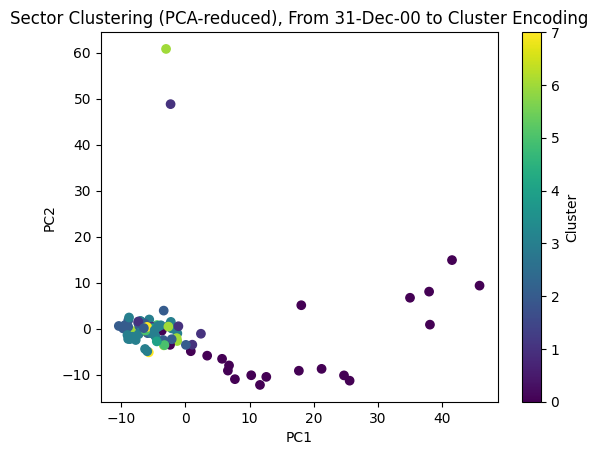

Overall Average pairwise correlation: 0.0002
Cluster Consumer Services Average pairwise correlation: 0.0003  17
             Code                                    Company    Market Cap             Sector
17  SHP SJ Equity        Shoprite Holdings Limited (JSE:SHP)  167337000000  Consumer Services
21  BID SJ Equity          Bid Corporation Limited (JSE:BID)  155313000000  Consumer Services
28  PPH SJ Equity          Pepkor Holdings Limited (JSE:PPH)  103966000000  Consumer Services
35  CLS SJ Equity             Clicks Group Limited (JSE:CLS)   87717100000  Consumer Services
38  MRP SJ Equity                   Mr Price Group (JSE:MRP)   57588200000  Consumer Services
44  MCG SJ Equity                MultiChoice Group (JSE:MCG)   51924400000  Consumer Services
45  WHL SJ Equity      Woolworths Holdings Limited (JSE:WHL)   51768100000  Consumer Services
51  TFG SJ Equity               The Foschini Group (JSE:TFG)   45380500000  Consumer Services
58  BOX SJ Equity             Boxer Retail

In [329]:
sector_averages = []
all_sector_info = pd.DataFrame()
pca = PCA(n_components=2)
components = pca.fit_transform(df_2_standardised.iloc[:,0:-2])
plt.scatter(components[:, 0], components[:, 1], c=df_2_standardised['Cluster Encoding'].values.tolist(), cmap="viridis")
plt.title(f"Sector Clustering (PCA-reduced), From {df_2_standardised.columns.values.tolist()[0]} to {df_2_standardised.columns.values.tolist()[-1]}")
plt.xlabel("PC1")
plt.ylabel("PC2")
plt.colorbar(label="Cluster")

overall_corr_matrix = df_2_standardised.iloc[:,0:-2].corr()
overall_upper_tri = overall_corr_matrix.where(np.triu(np.ones(overall_corr_matrix.shape), k=1).astype(bool))

# Step 3: Compute the mean of the upper triangle
overall_corr = overall_upper_tri.stack().mean()
plt.show()
print("Overall Average pairwise correlation:", round(overall_corr, 4))

cluster_list = df_2_standardised['Cluster'].unique().tolist()
for cluster in cluster_list:
    cluster_df = df_2_standardised[df_2_standardised['Cluster'] == cluster]
    cluster_df_numeric = cluster_df.iloc[:, 0:-2]
    sector_average = cluster_df_numeric.mean()
    sector_averages.append(sector_average)
    cluster_list = cluster_df.index.to_list()
    cluster_info = alse_consitutents[alse_consitutents["Code"].isin(cluster_list)]
    corr_matrix = cluster_df.iloc[:,0:-2].corr()
    upper_tri = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))
    avg_corr = upper_tri.stack().mean()
    print(f"Cluster {cluster} Average pairwise correlation: { round(avg_corr, 4)} ",cluster_df.shape[0] )
    print(cluster_info.to_string())
    all_sector_info = pd.concat([all_sector_info, cluster_info], ignore_index=True)

In [233]:
all_sector_info.to_csv("Sector_info.csv")

In [264]:
sector_map = dict(enumerate(df_2_standardised['Sector'].astype('category').cat.categories))

In [265]:
sector_map

{0: 'Basic Materials',
 1: 'Consumer Goods',
 2: 'Consumer Services',
 3: 'Financials',
 4: 'Health Care',
 5: 'Industrials',
 6: 'Technology',
 7: 'Telecommunications'}

In [321]:
df_2_standardised.to_csv('Returns_and_Sectors.csv')

In [319]:
df_2_standardised

,31-Dec-00,07-Jan-01,14-Jan-01,21-Jan-01,28-Jan-01,04-Feb-01,11-Feb-01,18-Feb-01,25-Feb-01,04-Mar-01,...,13-Apr-25,20-Apr-25,27-Apr-25,04-May-25,11-May-25,18-May-25,25-May-25,01-Jun-25,Cluster,Cluster Encoding
Stock,,,,,,,,,,,,,,,,,,,,,
WHL SJ Equity,0.080161,2.129169,1.950118,-0.301680,-0.092892,0.141628,-1.299154,-0.160184,-0.773186,0.152346,...,-0.013387,1.491542,-0.078211,0.281860,-0.672849,0.022920,-0.239076,0.107965,Consumer Services,2
WBO SJ Equity,-1.255789,-0.726758,-0.364253,0.123753,0.659636,2.425559,-1.676259,-0.655657,1.483938,2.444460,...,0.383773,-0.944187,1.081924,-0.735122,-0.672849,-0.181067,-0.670381,-0.671133,Industrials,5
WBC SJ Equity,-0.253826,0.701205,-0.542281,0.336469,0.659636,0.556888,-1.487706,1.161079,0.355376,0.152346,...,-0.013387,-1.248653,1.744858,-0.057134,0.467790,0.430894,-0.095307,0.627364,Technology,6
VOD SJ Equity,0.414149,-0.607761,0.970961,0.017394,-0.469156,-0.792708,1.340583,-1.068552,1.860125,-0.785337,...,-0.145774,0.578144,0.418989,0.281860,-0.672849,-0.181067,0.192230,-0.151734,Telecommunications,7
VKE SJ Equity,-0.921802,0.225218,-0.631296,-0.301680,0.032530,0.037813,0.209268,0.004974,0.355376,0.777468,...,-0.145774,0.578144,-0.575412,0.959849,0.467790,0.226907,-0.670381,0.627364,Financials,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ANG SJ Equity,-1.923765,-0.488764,-0.542281,-0.301680,0.157951,-1.311783,0.963478,-0.160184,2.424406,1.194216,...,2.634349,-0.944187,-1.735547,-1.074116,3.034228,-2.424922,1.198609,-0.930833,Basic Materials,0
AGL SJ Equity,-0.587814,1.415187,-0.008196,1.400051,-1.096262,2.010299,-0.544943,1.491395,0.167282,-0.681150,...,0.251386,-0.639721,0.916190,-1.413110,-0.958009,-0.385054,0.767304,-0.151734,Basic Materials,0
AFH SJ Equity,-0.420820,-0.191272,-0.720310,0.017394,0.220662,-0.948430,-1.864811,-0.573078,-0.538069,0.621187,...,-1.204869,-0.944187,0.584723,2.654819,2.463908,-0.385054,-0.095307,-0.411434,Financials,3


In [266]:
sector_averages_df = pd.DataFrame(sector_averages)
cluster_list = df_2_standardised['Cluster'].unique().tolist()
sector_averages_df["Sector"] = cluster_list
sector_averages_df = sector_averages_df.set_index('Sector')
sector_averages_df

,31-Dec-00,07-Jan-01,14-Jan-01,21-Jan-01,28-Jan-01,04-Feb-01,11-Feb-01,18-Feb-01,25-Feb-01,04-Mar-01,...,30-Mar-25,06-Apr-25,13-Apr-25,20-Apr-25,27-Apr-25,04-May-25,11-May-25,18-May-25,25-May-25,01-Jun-25
Sector,,,,,,,,,,,,,,,,,,,,,
2,0.560951,0.399435,0.569233,-0.515787,-0.006818,-0.181013,-0.059081,0.201167,0.029593,-0.380165,...,-0.103153,0.136731,-0.309311,-0.048698,0.233758,0.142274,-0.085755,-0.205065,-0.315188,0.062136
5,-0.253826,0.066555,-0.067539,-0.159869,0.241565,0.764518,-0.670645,-0.215236,0.731563,0.569094,...,-0.115493,-0.034712,-0.278161,-0.538232,0.584723,-0.170132,-0.577796,0.022920,-0.526613,-0.151734
6,0.553310,-0.191272,-0.571953,1.151882,0.304276,-0.083305,-0.419241,-0.215236,-1.008303,-0.524870,...,0.408938,0.664775,-0.653257,-0.588977,0.722834,0.168862,0.467790,0.770872,-0.382844,0.194531
7,0.887298,-0.419349,0.562979,-0.168732,0.116144,-0.308237,-0.489948,-0.985973,0.418074,-1.393095,...,1.169363,-0.151294,-0.410548,0.502027,0.791890,0.620854,-0.530269,0.685877,0.156288,0.692288
3,-0.395867,0.016631,-0.273192,-0.266227,-0.118120,-0.228885,0.049973,0.002127,-0.232146,0.091869,...,-0.227612,0.059759,-0.378593,0.525649,0.316120,0.480581,-0.151695,0.233941,-0.432419,0.421395
0,-0.142497,-0.266825,-0.041046,0.388804,0.257989,0.609208,0.084314,-0.038609,0.394562,0.472762,...,-0.100509,-0.675909,1.178094,-0.407747,-0.827958,-0.961118,0.345579,-0.589041,1.116456,-0.819533
1,0.043051,-0.508597,-0.013141,-0.106690,-0.685159,-0.481262,1.036804,0.404106,0.177732,0.013430,...,0.828483,0.956228,-0.079581,-0.791954,0.004655,-0.339629,-0.102529,0.396896,-0.191153,0.107965
4,-0.476485,1.335856,0.189614,1.069159,-0.260120,-0.250562,-0.649694,0.261887,-0.313401,0.268109,...,-0.430151,0.373322,-0.542935,0.679632,-1.680302,0.959849,0.087577,-0.249063,-0.382844,-0.065168


In [267]:
sector_averages_df = sector_averages_df.T
sector_averages_df_corr = sector_averages_df.corr()
overall_upper_tri = sector_averages_df_corr.where(np.triu(np.ones(sector_averages_df_corr.shape), k=1).astype(bool))
overall_corr = overall_upper_tri.stack().mean()
overall_corr

-0.07287507195899345

In [268]:
sector_averages_df_corr

Sector,2,5,6,7,3,0,1,4
Sector,,,,,,,,
2,1.000000,0.090197,-0.101027,0.077769,0.118923,-0.580528,-0.067342,0.104119
5,0.090197,1.000000,-0.066129,-0.014826,0.097022,-0.232484,-0.037479,0.044509
6,-0.101027,-0.066129,1.000000,-0.008898,-0.081269,-0.235333,0.343612,-0.042025
7,0.077769,-0.014826,-0.008898,1.000000,0.048861,-0.285836,-0.038277,0.056742
3,0.118923,0.097022,-0.081269,0.048861,1.000000,-0.701392,-0.137844,0.113957
0,-0.580528,-0.232484,-0.235333,-0.285836,-0.701392,1.000000,-0.189644,-0.280970
1,-0.067342,-0.037479,0.343612,-0.038277,-0.137844,-0.189644,1.000000,-0.034911
4,0.104119,0.044509,-0.042025,0.056742,0.113957,-0.280970,-0.034911,1.000000
